#### Author: Adam Van Etten - March 2022

# Notebook for testing adversarial patches

In [1]:
from shapely.affinity import translate
from torchvision import transforms
from shapely.geometry import box
import matplotlib.pyplot as plt
from shapely.wkt import loads
from torch import autograd
import skimage.transform
import matplotlib as mpl
import geopandas as gpd
from torch import optim
from imp import reload
from tqdm import tqdm
import pandas as pd 
import numpy as np
import collections
import skimage.io
import operator
import shapely
import random
import inspect
import shutil
import torch
import math
import time
import imp
import cv2
import sys
import os
import gc
import PIL
import warnings
warnings.filterwarnings('ignore')

yoltv4_path = '/local_data/cosmiq/src/avanetten/yoltv4/'
sys.path.append(os.path.join(yoltv4_path, 'yoltv4'))
import prep_train
import tile_ims_labels
import post_process
import eval as yolt_eval
#import eval_errors

# camo src
camo_path = '/local_data/cosmiq/src/avanetten/camolo'
sys.path.append(os.path.join(camo_path, 'camolo'))
sys.path.append(os.path.join(camo_path, 'camolo', 'yolt_data_prep'))
# camo_path = '/local_data/cosmiq/src/avanetten/camouflage'
# sys.path.append(os.path.join(camo_path, 'data_prep'))
# sys.path.append(os.path.join(camo_path, 'adversarial-yolt'))
import cowc_yolt_prep
import utils as camo_utils
import prep_train as camo_prep_train
# import load_data
import patch_config
# import test_patch

# patch data
patch_data_root = '/local_data/cosmiq/src/avanetten/camolo/patches'
# patch_data_root = '/local_data/cosmiq/src/avanetten/camouflage/data/patches'

# set raw dataset path (gpu02)
data_root = '/local_data/cosmiq/wdata/avanetten/VisDrone/data'

# output dirs
train_root = os.path.join(data_root, 'VisDrone2019-DET-train')
val_root = os.path.join(data_root, 'VisDrone2019-DET-val')
test_root = os.path.join(data_root, 'VisDrone2019-DET-test-dev')
exp_name = 'v1_4cat'
print("test_root:", test_root)

import multiprocessing
from functools import partial
def map_wrapper(x):
    return x[0](*(x[1:]))

test_root: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev


In [2]:
reload(patch_config)
patch_config.patch_configs

{'base': patch_config.BaseConfig,
 'exp1': patch_config.Experiment1,
 'exp1_des': patch_config.Experiment1Desktop,
 'exp2_high_res': patch_config.Experiment2HighRes,
 'exp3_low_res': patch_config.Experiment3LowRes,
 'exp4_class_only': patch_config.Experiment4ClassOnly,
 'paper_obj': patch_config.ReproducePaperObj,
 'cowc_obj_only_v4': patch_config.COWC_obj_only_v4,
 'cowc_obj_only_v3': patch_config.COWC_obj_only_v3,
 'cowc_obj_only_v2': patch_config.COWC_obj_only_v2,
 'cowc_obj_only_v1': patch_config.COWC_obj_only_v1,
 'cowc_obj_only': patch_config.COWC_obj_only,
 'visdrone_obj_only_v0': patch_config.visdrone_obj_only_v0,
 'visdrone_obj_class_v0': patch_config.visdrone_obj_class_v0,
 'visdrone_class_only_v0': patch_config.visdrone_class_only_v0,
 'visdrone_obj_only_small_v0': patch_config.visdrone_obj_only_small_v0,
 'visdrone_obj_only_small_gray_v0': patch_config.visdrone_obj_only_small_gray_v0,
 'visdrone_obj_only_small_gray_v1': patch_config.visdrone_obj_only_small_gray_v1,
 'visdro

In [3]:
# # View grid of latest patches (three plots per config)
# model_list_full = list(patch_config.patch_configs.keys())
# model_list = sorted([z for z in model_list_full if z.startswith('visdrone')])
# patch_master_dir = os.path.join(camo_path, 'adversarial-yolt', 'saved_patches')
# print("patch_master_dir:", patch_master_dir)
# # set up plot
# ncols, figsize = 3, 6
# nrows = len(model_list)
# fig, axes = plt.subplots(nrows=nrows, ncols=ncols,  figsize=(figsize*ncols, 0.95*figsize*nrows))
    
# for i, model in enumerate(model_list):
#     ax_row = axes[i]
#     config = patch_config.patch_configs[model]()
#     patch_dir = os.path.join(patch_master_dir, config.patch_name)
#     patch_list = sorted(os.listdir(patch_dir))
#     epochs = [int(z.split('epoch')[-1].split('.')[0]) for z in patch_list if z.endswith('.jpg')]
#     max_epoch = max(epochs)
#     for j, epoch in enumerate([0, int(max_epoch/2), max_epoch]):
#         print_name = os.path.join(config.patch_name, config.patch_name + '_epoch{}.jpg'.format(str(epoch)))
#         out_patch_path = os.path.join(patch_dir, config.patch_name + '_epoch{}.jpg'.format(str(epoch)))
#         if epoch == max_epoch:
#             print("model:", model)
#             # print("  patch_path:", out_patch_path)
#             print("  patch_name:", print_name)
#         im = skimage.io.imread(out_patch_path)
#         ax = ax_row[j]
#         ax.imshow(im)
#         ax.set_title('{}: epoch={}'.format(model, epoch))

In [4]:
# # View grid of latest patches (one plot per config)
# model_list_full = list(patch_config.patch_configs.keys())
# model_list = sorted([z for z in model_list_full if z.startswith('visdrone')])

# # set up plot
# ncols, figsize = 3, 9
# nrows = math.ceil(len(model_list) / ncols)
# fig, axes = plt.subplots(nrows=nrows, ncols=ncols,  figsize=(figsize*ncols, 0.95*figsize*nrows))
    
# for i, model in enumerate(model_list):
#     ax = axes.flatten()[i]
#     config = patch_config.patch_configs[model]()
#     patch_dir = os.path.join(camo_path, 'adversarial-yolt', 'saved_patches', config.patch_name)
#     patch_list = sorted(os.listdir(patch_dir))
#     epochs = [int(z.split('epoch')[-1].split('.')[0]) for z in patch_list if z.endswith('.jpg')]
#     max_epoch = max(epochs)
#     out_patch_path = os.path.join(patch_dir, config.patch_name + '_epoch{}.jpg'.format(str(max_epoch)))
#     im = skimage.io.imread(out_patch_path)
#     ax.imshow(im)
#     ax.set_title('{}: epoch={}'.format(model, max_epoch))

model_list: ['visdrone_obj_only_v0', 'visdrone_obj_class_v0', 'visdrone_class_only_v0', 'visdrone_obj_only_small_v0', 'visdrone_obj_only_small_gray_v0', 'visdrone_obj_only_small_gray_v1', 'visdrone_v1_4cat_obj_only_small_v1', 'visdrone_v1_4cat_obj_class_small_v2', 'visdrone_v1_4cat_obj_only_v2', 'visdrone_v1_4cat_obj_only_gray_v2', 'visdrone_v1_4cat_obj_class_v3', 'visdrone_v1_4cat_obj_class_v4', 'visdrone_v1_4cat_obj_only_v4', 'visdrone_v1_4cat_obj_only_v5', 'visdrone_v1_4cat_obj_only_v5p1', 'visdrone_v1_4cat_obj_only_v5p2', 'visdrone_v1_4cat_obj_only_v5p3', 'visdrone_v1_4cat_obj_only_gray_v2p1', 'visdrone_v1_4cat_obj_only_gray_v2p2', 'visdrone_v1_4cat_obj_only_gray_v2p3', 'visdrone_v1_4cat_class_only_v1', 'visdrone_v1_4cat_obj_only_tiny_v0', 'visdrone_v1_4cat_obj_only_tiny_gray_v0', 'visdrone_v1_4cat_obj_only_tiny_gray_v1']
len model_list: 24
 & Name & Loss & Size & Alpha \\
1 & obj\_only\_v0 & obj & $0.2$ & $0.4$ \\
2 & obj\_class\_v0 & obj * cls & $0.2$ & $0.4$ \\
3 & class\_only\_

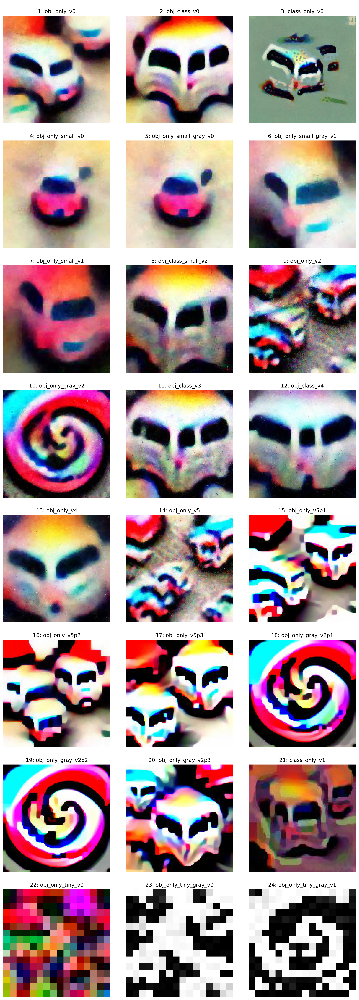

In [5]:
# View grid of latest patches, and plot patch params
plt.rcParams['figure.dpi'] = 300

model_list_full = list(patch_config.patch_configs.keys())
model_list = [z for z in model_list_full if z.startswith('visdrone')]
print("model_list:", model_list)
print("len model_list:", len(model_list))

# set up plot
ncols, figsize = 3, 4
nrows = int(len(model_list) / ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols,  figsize=(figsize*ncols, 0.99*figsize*nrows))
    
sep = " & "
sep2 = ""
header = sep + "Name" + sep +  "Loss" + sep + "Size" + sep + "Alpha" + r" \\"
print(header)

for i, model in enumerate(model_list):
    print_name = model.split("visdrone_")[-1].split("v1_4cat_")[-1]
    print_name_tab = print_name.replace(r'_', r'\_')
    c = patch_config.patch_configs[model]()
    patch_dir = os.path.join(camo_path, 'saved_patches', c.patch_name)
    # patch_dir = os.path.join(camo_path, 'adversarial-yolt', 'saved_patches', config.patch_name)
    patch_list = sorted(os.listdir(patch_dir))
    epochs = [int(z.split('epoch')[-1].split('.')[0]) for z in patch_list if z.endswith('.jpg')]
    max_epoch = max(epochs)
    out_patch_path = os.path.join(patch_dir, c.patch_name + '_epoch{}.jpg'.format(str(max_epoch)))
    im = skimage.io.imread(out_patch_path)
    ax = axes.flatten()[i]
    ax.imshow(im)
    ax.set_title("\n" + str(i + 1) + ": " + print_name)
    ax.axis('off')
    # ax.set_title('{}: epoch={}'.format(model, epoch))    
    
    # plot details
    func = c.loss_target
    loss_str = inspect.getsource(func).split(": ")[-1].strip()
    tab_row = str(i+1) + sep + print_name_tab + sep + loss_str + sep \
              + "$" + str(c.target_size_frac) + "$" + sep \
              + "$" + str(c.patch_alpha) + "$" + r" \\"
    print(tab_row)

plt.tight_layout()
plt.savefig('patch_grid.png')


In [6]:
## View some of the raw training images

# # visualize some of the outputs cutouts
# dir_tmp = os.path.join(train_root, 'yolt', exp_name, 'images_only')
# rows, cols = 3, 3
# figsize = 8
# paths_tmp = [os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)]
# rand_selection = random.sample(paths_tmp, rows*cols)
# fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize*cols, figsize*rows))
# for i in range(rows*cols):
#     ax = axes.flatten()[i]
#     im_path_tmp = rand_selection[i]
#     im_name_tmp = os.path.basename(im_path_tmp)
#     im = skimage.io.imread(im_path_tmp)
#     ax.imshow(im)
#     ax.set_title(im_name_tmp)

## Define models of interest

,model,label,name,path
0,visdrone_obj_only_v0,0,patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p...,/local_data/cosmiq/src/avanetten/camolo/saved_...
1,visdrone_obj_class_v0,1,patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p...,/local_data/cosmiq/src/avanetten/camolo/saved_...
2,visdrone_obj_only_small_v0,2,patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p...,/local_data/cosmiq/src/avanetten/camolo/saved_...
3,visdrone_v1_4cat_obj_only_small_v1,3,patch_yolt2_ave_26x26_alpha0p6_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
4,visdrone_v1_4cat_obj_class_v3,4,patch_yolt2_ave_26x26_alpha0p6_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
5,visdrone_v1_4cat_obj_only_v4,5,patch_yolt2_ave_26x26_alpha0p5_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
6,visdrone_v1_4cat_obj_only_v5,6,patch_yolt2_ave_26x26_alpha0p5_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
7,visdrone_v1_4cat_obj_only_v5p3,7,patch_yolt2_ave_26x26_alpha0p5_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
8,visdrone_v1_4cat_obj_only_gray_v2p2,8,patch_yolt2_ave_26x26_alpha0p8_grays_visdrone_...,/local_data/cosmiq/src/avanetten/camolo/saved_...
9,visdrone_v1_4cat_obj_only_gray_v2p3,9,patch_yolt2_ave_26x26_alpha0p8_grays_visdrone_...,/local_data/cosmiq/src/avanetten/camolo/saved_...


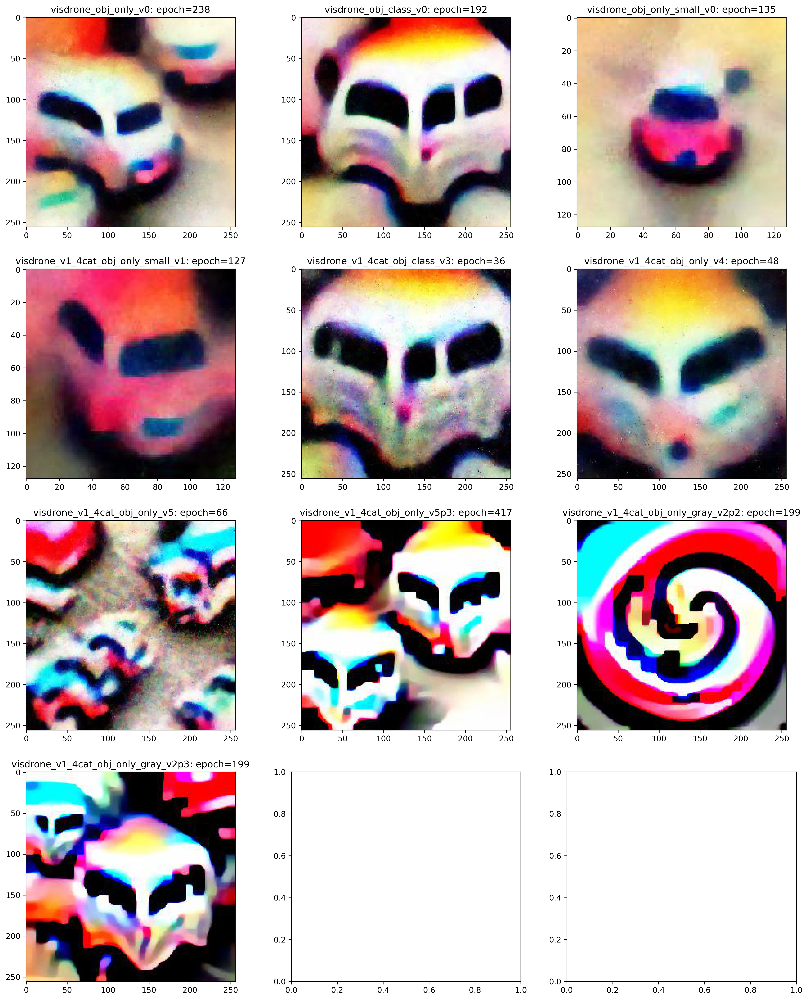

In [7]:
models_of_interest = [
 'visdrone_obj_only_v0',
 'visdrone_obj_class_v0',
 'visdrone_obj_only_small_v0',
 'visdrone_v1_4cat_obj_only_small_v1',
 'visdrone_v1_4cat_obj_class_v3',
 'visdrone_v1_4cat_obj_only_v4',
 'visdrone_v1_4cat_obj_only_v5',
 'visdrone_v1_4cat_obj_only_v5p3',
 'visdrone_v1_4cat_obj_only_gray_v2p2',
 'visdrone_v1_4cat_obj_only_gray_v2p3',
]

# define labels 
# View grid of latest patches (one plot per config)

# set up plot
ncols, figsize = 3, 6
nrows = math.ceil(len(models_of_interest) / ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols,  figsize=(figsize*ncols, 0.95*figsize*nrows))
    
name_list, path_list = [], []
for i, model in enumerate(models_of_interest):
    ax = axes.flatten()[i]
    config = patch_config.patch_configs[model]()
    patch_dir = os.path.join(camo_path, 'saved_patches', config.patch_name)
    # patch_dir = os.path.join(camo_path, 'adversarial-yolt', 'saved_patches', config.patch_name)
    patch_list = sorted(os.listdir(patch_dir))
    epochs = [int(z.split('epoch')[-1].split('.')[0]) for z in patch_list if z.endswith('.jpg')]
    max_epoch = max(epochs)
    name = config.patch_name + '_epoch{}.jpg'.format(str(max_epoch))
    out_patch_path = os.path.join(patch_dir, name)
    name_list.append(name)
    path_list.append(out_patch_path)
    im = skimage.io.imread(out_patch_path)
    ax.imshow(im)
    ax.set_title('{}: epoch={}'.format(model, max_epoch))
    
# make a dataframe of patches of interest
# print("name_list:", name_list)
# print("path_list:", path_list)
df_patches = pd.DataFrame({'model': models_of_interest, 'label': range(len(name_list)), 'name': name_list, 'path': path_list})
display(df_patches)

In [8]:
# Get all patches

model_list_all = list(patch_config.patch_configs.keys())
model_list_visdrone = [z for z in model_list_all if z.startswith('visdrone')]
#model_list_visdrone = sorted([z for z in model_list_all if z.startswith('visdrone')])
# create list of all models, starting with models of interest
model_list_new = []
model_list_full = models_of_interest.copy()
for m in model_list_visdrone:
    if m not in models_of_interest:
        model_list_new.append(m)
        model_list_full.append(m)
print("model_list_new:", model_list_new)

# make df of patches (all models)
m_list, name_list, path_list = model_list_full, [], []
for i, model in enumerate(m_list):
    config = patch_config.patch_configs[model]()
    patch_dir = os.path.join(camo_path, 'saved_patches', config.patch_name)
    # patch_dir = os.path.join(camo_path, 'adversarial-yolt', 'saved_patches', config.patch_name)
    patch_list = sorted(os.listdir(patch_dir))
    epochs = [int(z.split('epoch')[-1].split('.')[0]) for z in patch_list if z.endswith('.jpg')]
    max_epoch = max(epochs)
    name = config.patch_name + '_epoch{}.jpg'.format(str(max_epoch))
    out_patch_path = os.path.join(patch_dir, name)
    name_list.append(name)
    path_list.append(out_patch_path)
df_patches_all = pd.DataFrame({'model': m_list, 'label': range(len(name_list)), 'name': name_list, 'path': path_list})

display(df_patches_all)

model_list_new: ['visdrone_class_only_v0', 'visdrone_obj_only_small_gray_v0', 'visdrone_obj_only_small_gray_v1', 'visdrone_v1_4cat_obj_class_small_v2', 'visdrone_v1_4cat_obj_only_v2', 'visdrone_v1_4cat_obj_only_gray_v2', 'visdrone_v1_4cat_obj_class_v4', 'visdrone_v1_4cat_obj_only_v5p1', 'visdrone_v1_4cat_obj_only_v5p2', 'visdrone_v1_4cat_obj_only_gray_v2p1', 'visdrone_v1_4cat_class_only_v1', 'visdrone_v1_4cat_obj_only_tiny_v0', 'visdrone_v1_4cat_obj_only_tiny_gray_v0', 'visdrone_v1_4cat_obj_only_tiny_gray_v1']


,model,label,name,path
0,visdrone_obj_only_v0,0,patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p...,/local_data/cosmiq/src/avanetten/camolo/saved_...
1,visdrone_obj_class_v0,1,patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p...,/local_data/cosmiq/src/avanetten/camolo/saved_...
2,visdrone_obj_only_small_v0,2,patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p...,/local_data/cosmiq/src/avanetten/camolo/saved_...
3,visdrone_v1_4cat_obj_only_small_v1,3,patch_yolt2_ave_26x26_alpha0p6_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
4,visdrone_v1_4cat_obj_class_v3,4,patch_yolt2_ave_26x26_alpha0p6_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
5,visdrone_v1_4cat_obj_only_v4,5,patch_yolt2_ave_26x26_alpha0p5_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
6,visdrone_v1_4cat_obj_only_v5,6,patch_yolt2_ave_26x26_alpha0p5_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
7,visdrone_v1_4cat_obj_only_v5p3,7,patch_yolt2_ave_26x26_alpha0p5_32vals_visdrone...,/local_data/cosmiq/src/avanetten/camolo/saved_...
8,visdrone_v1_4cat_obj_only_gray_v2p2,8,patch_yolt2_ave_26x26_alpha0p8_grays_visdrone_...,/local_data/cosmiq/src/avanetten/camolo/saved_...
9,visdrone_v1_4cat_obj_only_gray_v2p3,9,patch_yolt2_ave_26x26_alpha0p8_grays_visdrone_...,/local_data/cosmiq/src/avanetten/camolo/saved_...


In [9]:
model_list_full

['visdrone_obj_only_v0',
 'visdrone_obj_class_v0',
 'visdrone_obj_only_small_v0',
 'visdrone_v1_4cat_obj_only_small_v1',
 'visdrone_v1_4cat_obj_class_v3',
 'visdrone_v1_4cat_obj_only_v4',
 'visdrone_v1_4cat_obj_only_v5',
 'visdrone_v1_4cat_obj_only_v5p3',
 'visdrone_v1_4cat_obj_only_gray_v2p2',
 'visdrone_v1_4cat_obj_only_gray_v2p3',
 'visdrone_class_only_v0',
 'visdrone_obj_only_small_gray_v0',
 'visdrone_obj_only_small_gray_v1',
 'visdrone_v1_4cat_obj_class_small_v2',
 'visdrone_v1_4cat_obj_only_v2',
 'visdrone_v1_4cat_obj_only_gray_v2',
 'visdrone_v1_4cat_obj_class_v4',
 'visdrone_v1_4cat_obj_only_v5p1',
 'visdrone_v1_4cat_obj_only_v5p2',
 'visdrone_v1_4cat_obj_only_gray_v2p1',
 'visdrone_v1_4cat_class_only_v1',
 'visdrone_v1_4cat_obj_only_tiny_v0',
 'visdrone_v1_4cat_obj_only_tiny_gray_v0',
 'visdrone_v1_4cat_obj_only_tiny_gray_v1']

In [10]:
# new_list = ['visdrone_v1_4cat_obj_only_tiny_v0', 'visdrone_v1_4cat_obj_only_tiny_gray_v0']
new_list = ['visdrone_v1_4cat_obj_only_tiny_gray_v1']
df_patches_newnew = df_patches_all[df_patches_all['model'].isin(new_list)]
df_patches_newnew

,model,label,name,path
23,visdrone_v1_4cat_obj_only_tiny_gray_v1,23,patch_yolt2_ave_26x26_alpha0p75_visdrone_v1_4c...,/local_data/cosmiq/src/avanetten/camolo/saved_...


# Add patches to images 

## Make a test dir for each model

Apply the patch to all test images (multiprocess)

In [16]:
generic_label_int = 0
n_threads = 12
root = test_root
df_patch_tmp = df_patches_all

# create dict of patches
model_dict = {}
for idx, row in df_patch_tmp.iterrows():
    model_tmp = row['model']
    config = patch_config.patch_configs[model_tmp]()
    alpha = config.patch_alpha
    size = config.target_size_frac
    model_dict[model_tmp] = {'label': row['label'], 'path': row['path'], 
                         'alpha': alpha, 'size': size}
print("model_dict:", model_dict)


def make_test_dir(model, im_ext='.jpg'):
    '''Create a directory for testing'''
    outname = model
    print("\nModel:", model)

    # Define paths
    input_im_dir = os.path.join(root, 'yolt/v1_4cat/images')
    input_label_dir = os.path.join(root, 'yolt/v1_4cat/labels')

    outdir = os.path.join(root, 'yolt', 'patches_applied', outname)
    outdir_txt = os.path.join(outdir, 'txt')
    outdir_images = os.path.join(outdir, 'images')
    outdir_labels = os.path.join(outdir, 'labels')
    outdir_gdf = os.path.join(outdir, 'gdf')
    outdir_labels_precise = os.path.join(outdir, 'labels_precise')
    outdir_gdf_precise = os.path.join(outdir, 'gdf_precise')

    try:
        for z in (outdir_images, outdir_labels, outdir_txt, outdir_gdf,
             outdir_labels_precise, outdir_gdf_precise):
            os.makedirs(z)
    except:
        print("Outputs already exist, returning")
        return

    patches_csv = os.path.join(outdir_txt, 'labels.txt')
    print("Patch classes csv:", patches_csv)
    if not os.path.exists(patches_csv):
        df_patch_tmp.to_csv(patches_csv)

    # iterate through images
    im_names = [z for z in os.listdir(input_im_dir) if z.endswith(im_ext)]
    for i,im_name in enumerate(im_names):
        # set outputs
        im_root = im_name.split('.')[0]
        im_outfile = os.path.join(outdir_images, im_name)

        label_outfile = os.path.join(outdir_labels, im_root + '.txt')
        outfile_gdf = os.path.join(outdir_gdf, im_root + '.geojson')
        label_outfile_precise = os.path.join(outdir_labels_precise, im_root + '.txt')
        outfile_gdf_precise = os.path.join(outdir_gdf_precise, im_root + '.geojson')

        # read image and labels
        label_path = os.path.join(input_label_dir,  im_root + '.txt')
        im_path = os.path.join(input_im_dir, im_name)
        # im = skimage.util.img_as_float(skimage.io.imread(im_path))
        im = skimage.util.img_as_ubyte(skimage.io.imread(im_path))
        # print("im.shape:", im.shape)

        w, h = im.shape[:2]
        if h != w:
            print("Skipping non-square image:", im_path)
            continue
        if (i % 250) == 0:
            print(i, "/", len(im_names), im_name, "w, h:", w, h)

        # read in labels
        df_labels = pd.read_csv(label_path, sep=' ', names=['cat', 'x', 'y', 'w', 'h'])

        # skip empty regions
        if len(df_labels) == 0:
            continue

        # iterate through labels
        arr_for_json = [['image_fname', 'image_path', 'model', 'patch_idx', 'patch_path', 'geometry']]
        out_arr = []
        arr_for_json_precise = [['image_fname', 'image_path', 'model', 'patch_idx', 'patch_path', 'geometry']]
        out_arr_precise = []
        for idx, row in df_labels.iterrows():

            # # only add patches to category of interest?
            # cls_row = int(row['cat'])
            # if cls_row != visdrone_cls_id:
            #     continue

            # select random patch to apply?
            # model_tmp = random.sample(model_dict.keys(), 1)[0]
            model_tmp = model
            size_tmp = model_dict[model_tmp]['size']
            alpha_tmp = model_dict[model_tmp]['alpha']
            label_tmp = generic_label_int # model_dict[model_tmp]['label']
            patch_path_tmp = model_dict[model_tmp]['path']

            # set mask_tmp
            mask_tmp = np.zeros((h, w, 3))

            # convert to pixel coords
            box = row.values[1:]
            [x0_in, x1_in, y0_in, y1_in] = prep_train.convert_reverse((w, h), box)
            xm, ym = 0.5 * (x0_in + x1_in), 0.5 * (y0_in + y1_in)

            # set patch size
            # # set size of patch (mimic line 237 of load_data.py in adversarial-yolt)?
            size = int(np.rint(np.sqrt( (size_tmp * (x1_in - x0_in))**2 + (size_tmp * (y1_in - y0_in))**2)))
            # print("size:", size)

            # set location of patch
            x0, y0 = int(xm - size/2.0), int(ym - size/2.0)
            # make sure x0, y0 are within range of image
            x0, y0 = max(0, x0), max(0, y0)
            x0, y0 = min(x0, w-size), min(y0, h-size)
            # set x1, y1
            x1, y1 = x0 + size, y0 + size
            # y0, y1 = int(ym - size/2.0), int(ym + size/2.0)
            geometry = shapely.geometry.box(x0, y0, x1, y1)

            # apply patch to mask
            # If patch_alpha == 1 (default), just overwrite the background image values with the patch values.
            # Else, blend the patch with the image
            # See: https://learnopencv.com/alpha-blending-using-opencv-cpp-python/
            #      https://stackoverflow.com/questions/49737541/merge-two-images-with-alpha-channel/49738078
            #     I = \alpha F + (1 - \alpha) B
            #         F = foregraound (patch, or adv_batch)
            #         B = background (image, or img_batch)
            # keep only first three channels (discard alpha)
            patch_raw = skimage.util.img_as_ubyte(skimage.io.imread(patch_path_tmp)[:,:,:3])
            # resize patch
            output_shape = (size, size)
            patch_resized = skimage.util.img_as_ubyte(skimage.transform.resize(patch_raw, output_shape))
            # patch_im_tmp_big = skimage.util.img_as_ubyte(skimage.io.imread(patch_path_tmp))
            # # print('patch_im_tmp_big.shape', patch_im_tmp_big.shape)
            # patch_im_tmp = skimage.transform.resize(patch_im_tmp_big, (size, size)) #, preserve_range=True)
            # # print('patch_im_tmp.shape', patch_im_tmp.shape)

            # randomly flip patch
            if random.choice([True, False]):
                patch_resized = skimage.util.img_as_ubyte(np.flipud(patch_resized))

            # randomly rotate
            if random.choice([True, False]):
                angle = random.choice([90, 270])
                patch_resized = skimage.util.img_as_ubyte(skimage.transform.rotate(patch_resized, angle))

            # # randomly flip patch
            # if random.choice([True, False]):
            #    patch_im_tmp = np.flipud(patch_im_tmp)
            # # randomly rotate
            # if random.choice([True, False]):
            #     angle = random.choice([90, 270])
            #     patch_im_tmp = skimage.transform.rotate(patch_im_tmp, angle)

            # assign patch_im_tmp to mask_tmp
            mask_tmp[y0:y1, x0:x1, :] = patch_resized

            # alpha blend
            alpha_blend = (alpha_tmp * mask_tmp) + ((1.0 - alpha_tmp) * im)
            # apply blend where patch is non_zero
            im = np.where(mask_tmp == (0,0,0), im, alpha_blend).astype(np.uint8)

            # labels
            (xout, yout, wout, hout) = prep_train.convert((w, h), [x0, x1, y0, y1])

            out_arr.append([generic_label_int, xout, yout, wout, hout])
            arr_for_json.append([im_root, im_path, model_tmp, generic_label_int, patch_path_tmp, geometry])

            out_arr_precise.append([label_tmp, xout, yout, wout, hout])
            arr_for_json_precise.append([im_root, im_path, model_tmp, label_tmp, patch_path_tmp, geometry])

        # define output labels
        df_out = pd.DataFrame(out_arr, columns=['cat', 'x', 'y', 'w', 'h'])
        df_out_precise = pd.DataFrame(out_arr_precise, columns=['cat', 'x', 'y', 'w', 'h'])
        # save labels
        df_out.to_csv(label_outfile, sep=' ', header=False, index=False)
        df_out_precise.to_csv(label_outfile_precise, sep=' ', header=False, index=False)

        # save image
        skimage.io.imsave(im_outfile, im)

        # Make a gdf_pix for each image, necessary for eval
        df_tmp_json = pd.DataFrame(arr_for_json[1:], columns=arr_for_json[0])
        df_tmp_json['im_name_root'] = df_tmp_json['image_fname']
        df_tmp_json['patch_name'] = [os.path.basename(p).split('.')[0] for p in df_tmp_json['patch_path']]
        gdf_pix = gpd.GeoDataFrame(df_tmp_json)
        gdf_pix.to_file(outfile_gdf, driver='GeoJSON')    

        df_tmp_json = pd.DataFrame(arr_for_json_precise[1:], columns=arr_for_json_precise[0])
        df_tmp_json['im_name_root'] = df_tmp_json['image_fname']
        df_tmp_json['patch_name'] = [os.path.basename(p).split('.')[0] for p in df_tmp_json['patch_path']]
        gdf_pix = gpd.GeoDataFrame(df_tmp_json)
        gdf_pix.to_file(outfile_gdf_precise, driver='GeoJSON')    

        
##############
# multiprocess
    
import multiprocessing
from functools import partial
def map_wrapper(x):
    return x[0](*(x[1:]))

# get args
input_args = []
for idx,row in df_patches_all.iterrows():
    model = row['model']
    input_args.append([make_test_dir, model])

print("input_args:", input_args)
with multiprocessing.Pool(n_threads) as pool:
    pool.map(map_wrapper, input_args)


model_dict: {'visdrone_obj_only_v0': {'label': 0, 'path': '/local_data/cosmiq/src/avanetten/camolo/saved_patches/patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p4_30vals_obj_only_v0/patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p4_30vals_obj_only_v0_epoch238.jpg', 'alpha': 0.4, 'size': 0.2}, 'visdrone_obj_class_v0': {'label': 1, 'path': '/local_data/cosmiq/src/avanetten/camolo/saved_patches/patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p4_32vals_obj_class_v0/patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p4_32vals_obj_class_v0_epoch192.jpg', 'alpha': 0.4, 'size': 0.2}, 'visdrone_obj_only_small_v0': {'label': 2, 'path': '/local_data/cosmiq/src/avanetten/camolo/saved_patches/patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p3_30vals_obj_only_small_v0/patch_yolt2_ave_26x26_visdrone_v1_4cat_alpha0p3_30vals_obj_only_small_v0_epoch135.jpg', 'alpha': 0.3, 'size': 0.2}, 'visdrone_v1_4cat_obj_only_small_v1': {'label': 3, 'path': '/local_data/cosmiq/src/avanetten/camolo/saved_patches/patch_yolt2_ave_26x26


Model:
Model:
Model:
Model:
Model:
Model:
Model:  
Model:
Model:   

In [104]:
# edit geojsons to make sure category_generic:'patch' is in proposals too
root = test_root
n_threads = 12

def edit_json_dir(model):
    
    outdir_gdf = os.path.join(root, 'yolt', 'patches_applied', model, 'gdf')
    print("outdir_gdf:", outdir_gdf)
    json_names = [z for z in os.listdir(outdir_gdf) if z.endswith('.geojson')]

    for i,json_name in enumerate(json_names):
        if (i % 1000) == 0:
            print(i, json_name)
        # set outputs
        outfile_gdf = os.path.join(outdir_gdf, json_name)
        gdf_pix = gpd.read_file(outfile_gdf)
        # add 'category_generic'
        gdf_pix['category_generic'] = 'patch'
        # save
        gdf_pix.to_file(outfile_gdf, driver='GeoJSON')  
        
# get args
input_args = []
#for idx,row in df_patches_all.iterrows():
for idx,row in df_patches_newnew.iterrows():
    model = row['model']
    input_args.append([edit_json_dir, model])

with multiprocessing.Pool(n_threads) as pool:
    pool.map(map_wrapper, input_args)


outdir_gdf: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/gdf
0 9999938_00000_d_0000011__x0_984_y0_372_dxdy_416.geojson
1000 9999938_00000_d_0000514__x0_0_y0_353_dxdy_416.geojson
2000 9999952_00000_d_0000281__x0_353_y0_0_dxdy_416.geojson
3000 9999973_00000_d_0000050__x0_353_y0_662_dxdy_416.geojson
4000 9999938_00000_d_0000058__x0_706_y0_372_dxdy_416.geojson
5000 9999938_00000_d_0000357__x0_984_y0_372_dxdy_416.geojson
6000 9999938_00000_d_0000214__x0_353_y0_353_dxdy_416.geojson
7000 9999952_00000_d_0000317__x0_353_y0_353_dxdy_416.geojson
8000 9999993_00000_d_0000011__x0_706_y0_0_dxdy_416.geojson
9000 9999973_00000_d_0000033__x0_1059_y0_662_dxdy_416.geojson
10000 9999938_00000_d_0000419__x0_706_y0_372_dxdy_416.geojson
11000 9999952_00000_d_0000049__x0_706_y0_0_dxdy_416.geojson


config.patch_alpha: 0.75
config.target_size_frac: 0.2

Plotting yolt training bounding boxes...
  outdir_labels: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/labels
  outdir_ims: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/images
  outdir_yolt_plots: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/yolt_plot_bboxes


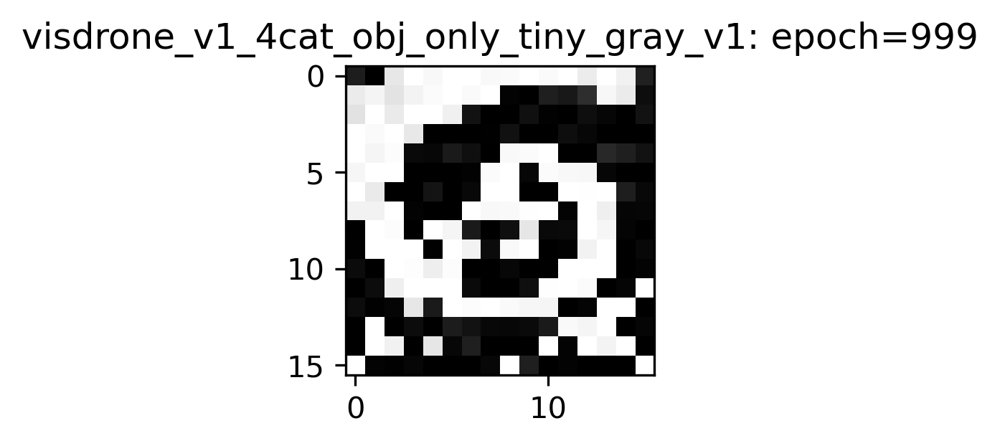

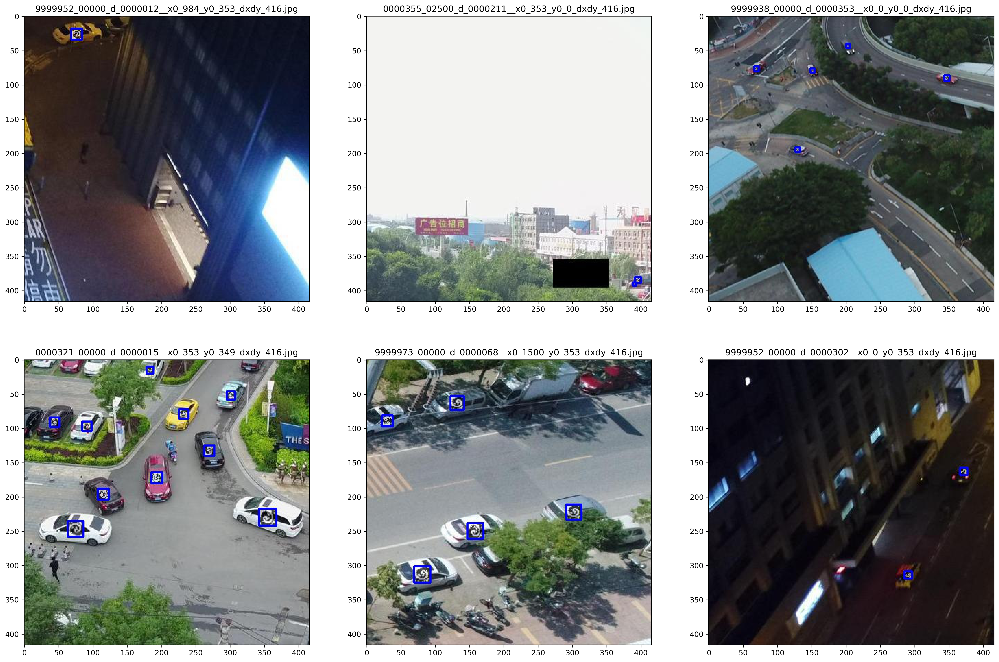

In [11]:
# make sure labels and images are created correctly by invoking plot_training_bboxes()

# outname = 'visdrone_obj_only_small_v0'
outname = 'visdrone_v1_4cat_obj_only_tiny_gray_v1'
root = test_root

# set up plot
model_tmp = outname
ncols, figsize = 1, 2
nrows = 1 # math.ceil(len(models_of_interest) / ncols)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols,  figsize=(figsize*ncols, 0.95*figsize*nrows))
    
ax = axes
config = patch_config.patch_configs[model_tmp]()
print("config.patch_alpha:", config.patch_alpha)
print("config.target_size_frac:", config.target_size_frac)
patch_dir = os.path.join(camo_path,  'saved_patches', config.patch_name)
patch_list = sorted(os.listdir(patch_dir))
epochs = [int(z.split('epoch')[-1].split('.')[0]) for z in patch_list if z.endswith('.jpg')]
max_epoch = max(epochs)
name = config.patch_name + '_epoch{}.jpg'.format(str(max_epoch))
out_patch_path = os.path.join(patch_dir, name)
name_list.append(name)
path_list.append(out_patch_path)
im = skimage.io.imread(out_patch_path)
ax.imshow(im)
ax.set_title('{}: epoch={}'.format(model_tmp, max_epoch))


# labeld boxes
input_im_dir = os.path.join(root, 'yolt/v1_4cat/images')
input_label_dir = os.path.join(root, 'yolt/v1_4cat/labels')
outdir = os.path.join(root, 'yolt', 'patches_applied', outname)

outdir_txt = os.path.join(outdir, 'txt')
outdir_images = os.path.join(outdir, 'images')
outdir_labels = os.path.join(outdir, 'labels')
outdir_gdf = os.path.join(outdir, 'gdf')
 
outdir_yolt_plots = os.path.join(outdir, 'yolt_plot_bboxes')
yolt_image_ext = '.jpg'
max_plots = 30

os.makedirs(outdir_yolt_plots, exist_ok=True)
print ("\nPlotting yolt training bounding boxes..." )
print ("  outdir_labels:", outdir_labels )
print ("  outdir_ims:", outdir_images)
print ("  outdir_yolt_plots:",  outdir_yolt_plots )

prep_train.plot_training_bboxes(outdir_labels, outdir_images, 
             ignore_augment=True,
             figsize=(10,10), color=(0,0,255), thickness=2, 
             max_plots=max_plots, sample_label_vis_dir=outdir_yolt_plots,
             ext=yolt_image_ext, show_plot=False, 
             specific_labels=[], label_dic=[], output_width=500,
             shuffle=True, verbose=False) 

# visualize some of the yolt labels
dir_tmp = outdir_yolt_plots
rows, cols = 2, 3
figsize = 8
paths_tmp = [os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)]
rand_selection = random.sample(paths_tmp, rows*cols)
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(figsize*cols, figsize*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = rand_selection[i]
    im_name_tmp = os.path.basename(im_path_tmp)
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    ax.set_title(im_name_tmp)
plt.show()

# Train model to detect patches

### Make list of images and .data file

In [12]:
exp_name = 'v1_4cat'
names_file = os.path.join(test_root, 'yolt', exp_name, 'txt', 'visdrone_v1_4cat.names')
print("names_file:", names_file)

names_file: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_v1_4cat.names


In [13]:
# create .txt and .data files of image paths

exp_name = 'v1_4cat'
names_file = os.path.join(test_root, 'yolt', exp_name, 'txt', 'visdrone_v1_4cat.names')
classnum = 4
print("names_file:", names_file)
!echo {names_file}

roots = [test_root]
df_patches_tmp = df_patches_newnew #df_patches_all
for root in roots:

    for idx,row in df_patches_tmp.iterrows():
        model = row['model']
        outname = model
        print("\nModel:", model)
    
        # Define paths
        input_im_dir = os.path.join(root, 'yolt/v1_4cat/images')
        input_label_dir = os.path.join(root, 'yolt/v1_4cat/labels')

        outdir = os.path.join(root, 'yolt', 'patches_applied', outname)
        outdir_txt = os.path.join(outdir, 'txt')
        outdir_images = os.path.join(outdir, 'images')
        outdir_labels = os.path.join(outdir, 'labels')
        outdir_gdf = os.path.join(outdir, 'gdf')
        outdir_labels_precise = os.path.join(outdir, 'labels_precise')
        outdir_gdf_precise = os.path.join(outdir, 'gdf_precise')

        # make list of images
        outpath_txt_tmp = os.path.join(outdir_txt, outname + '_imlist.txt')
        im_dir_tmp = outdir_images
        im_list = [os.path.join(im_dir_tmp, z) for z in os.listdir(im_dir_tmp) if z.endswith('.jpg')]
        df_tmp = pd.DataFrame({'image': im_list})
        df_tmp.to_csv(outpath_txt_tmp, header=False, index=False)
        print("\nOutpath:\n", outpath_txt_tmp)
        print("  N images:", len(df_tmp))

        # # make names file as well?
        # outpath_names = os.path.join(outdir_txt, outname + '.names')
        # print("  outpath_names:", outpath_names)
        # df_patches.sort_values('label').to_csv(outpath_names, index=False, 
        #                                        header=False, columns=['model'])
        
        # .data file
        outfile_data_test = os.path.join(outdir_txt, outname + '.data')

        # test
        !echo 'classes = ' {classnum} > {outfile_data_test}
        !echo 'train = "" '  >> {outfile_data_test}
        !echo 'valid = ' {outpath_txt_tmp} >> {outfile_data_test}
        !echo 'names = ' {names_file} >> {outfile_data_test}
        !echo 'backup = backup/' >> {outfile_data_test}

        print("\nhead:", outfile_data_test)
        !cat {outfile_data_test}


names_file: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_v1_4cat.names
/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/txt/visdrone_v1_4cat.names

Model: visdrone_v1_4cat_obj_only_tiny_gray_v1

Outpath:
 /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt/visdrone_v1_4cat_obj_only_tiny_gray_v1_imlist.txt
  N images: 11236

head: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt/visdrone_v1_4cat_obj_only_tiny_gray_v1.data
classes =  4
train = "" 
valid =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt/visdrone_v1_4cat_obj_only_tiny_gray_v1_imlist.txt
names =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-

## Execute test

In [19]:
# create testing commands
cfg_file = 'cfg/_backup/yolt2_ave_26x26_visdrone_v1_4cat.cfg'
weight_file = 'backup/yolt2_ave_26x26_visdrone_v1_4cat_final.weights'

root = test_root
df_patch_tmp = df_patches_all

# for idx,row in df_patches_all.iterrows():
for idx,row in df_patches_newnew.iterrows():
    model = row['model']
    outname = model
    outname_yolt = outname + '_patches_applied_'
    outdir = os.path.join(root, 'yolt', 'patches_applied', outname)
    outdir_txt = os.path.join(outdir, 'txt')
    outfile_data_test = os.path.join(outdir_txt, outname + '.data')
    
    test_str = './darknet detector valid ' + outfile_data_test + ' ' \
        + cfg_file + ' ' + weight_file + ' ' \
        + '-out ' + outname_yolt
    
    print("\n#Model:", model)
    print("#test_str:\n")
    print(test_str)

print("\n#")


#Model: visdrone_v1_4cat_obj_only_tiny_gray_v1
#test_str:

./darknet detector valid /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt/visdrone_v1_4cat_obj_only_tiny_gray_v1.data cfg/_backup/yolt2_ave_26x26_visdrone_v1_4cat.cfg backup/yolt2_ave_26x26_visdrone_v1_4cat_final.weights -out visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied_

#


In [17]:
df_patches_newnew

,model,label,name,path
23,visdrone_v1_4cat_obj_only_tiny_gray_v1,23,patch_yolt2_ave_26x26_alpha0p75_visdrone_v1_4c...,/local_data/cosmiq/src/avanetten/camolo/saved_...


In [21]:
# post process (multithread)
import warnings
warnings.filterwarnings('ignore')
reload(post_process)

n_threads = 12
extract_chips = False # True
detection_threshes = [0.3]  # [0.3, 0.35, 0.45]  #
slice_size = 0 # 416
sep = 'nope'
im_ext = '.jpg'
chip_ext = '.jpg'
show_labels = True
n_plots = 100
chip_rescale_frac = 1.1
allow_nested_detections = False # True
truth_file_name = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/gdf_pix_tot.geojson'
# truth_file_name = ''
verbose = False

def post_process_one(model, outname, outname0):
    
    print("outname:", outname)
    raw_im_dir = os.path.join(test_root, 'yolt', 'patches_applied', outname0, 'images')
    # proot = outname.split('yolt2_ave_26x26_visdrone_')[-1]
    # raw_im_dir = os.path.join(test_root, 'yolt', proot, 'images')
    for detection_thresh in detection_threshes:
        out_dir_root = os.path.join(yoltv4_path, 'darknet', 'results', outname)
        pred_dir = os.path.join(out_dir_root, 'orig_txt')
        out_csv = 'preds_refine_' + str(detection_thresh).replace('.', 'p') + '.csv'
        out_geojson_geo_dir = 'geojsons_geo_' + str(detection_thresh).replace('.', 'p')
        out_geojson_pix_dir = 'geojsons_pix_' + str(detection_thresh).replace('.', 'p')
        if extract_chips:
            out_dir_chips = 'detection_chips_' + str(detection_thresh).replace('.', 'p')
        else:
            out_dir_chips = ''
        plot_dir = 'pred_plots2_' + str(detection_thresh).replace('.', 'p')
        pred_txt_prefix = outname + '_'

        if len(truth_file_name) > 0:
            truth_file = truth_file_name
            # truth_file = os.path.join(data_root, 'test', 'geojsons_pix_comb', truth_file_name)
        else:
            truth_file = ''
        # move raw predictions to output dir
        os.makedirs(os.path.join(out_dir_root, 'orig_txt'), exist_ok=True)
        !mv {yoltv4_path}/darknet/results/{outname}*.txt {out_dir_root}/orig_txt/

        # post_process
        post_process.execute(
            pred_dir=pred_dir,
            truth_file=truth_file,
            raw_im_dir=raw_im_dir,
            # sliced_im_dir=sliced_im_dir,
            out_dir_root=out_dir_root,
            out_csv=out_csv,
            out_geojson_geo_dir=out_geojson_geo_dir,
            out_geojson_pix_dir=out_geojson_pix_dir,
            plot_dir=plot_dir,
            out_dir_chips=out_dir_chips,
            im_ext=im_ext,
            chip_ext=chip_ext,
            chip_rescale_frac=chip_rescale_frac,
            allow_nested_detections=allow_nested_detections,
            slice_size=slice_size,
            sep=sep,
            pred_txt_prefix=pred_txt_prefix,
            n_plots=n_plots,
            show_labels=show_labels,
            detection_thresh=detection_thresh,
            verbose=verbose)
        
        
##############
# multiprocess
    
import multiprocessing
from functools import partial
def map_wrapper(x):
    return x[0](*(x[1:]))

# get args
input_args = []
# for idx,row in df_patches_all.iterrows():
for idx,row in df_patches_newnew.iterrows():
    model = row['model']
    outname0 = model
    outname = model + '_patches_applied'
    input_args.append([post_process_one, model, outname, outname0])

with multiprocessing.Pool(n_threads) as pool:
    pool.map(map_wrapper, input_args)


outname: visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied
mv: cannot stat '/local_data/cosmiq/src/avanetten/yoltv4//darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied*.txt': No such file or directory
Augmenting dataframe of initial length: 57473 ...
0
10000
20000
30000
40000
50000
Time to augment dataframe of length: 57473 = 0.6477310657501221 seconds
Running refine_df()...
Initial length: 57473 Final length: 50037
Time to run refine_df(): 12.808993577957153 seconds

Creating geojsons and plots...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making ou

In [15]:
plot_iter = 6

In [16]:
# plot detections
mpl.rcParams['figure.dpi'] = 300

outnames = [#'visdrone_v1_4cat_obj_only_gray_v2p3_patches_applied',
            #'visdrone_v1_4cat_obj_only_v5_patches_applied'
            #'visdrone_obj_only_small_v0_patches_applied'
            'visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied'
           ]
outname = outnames[0]
show_axes = False
dir_tmp = os.path.join('/local_data/cosmiq/src/avanetten/yoltv4/darknet/results/',
            outname,
           'pred_plots2_0p3')
rows, cols = 5, 3
figsize = 8
# random images
paths_tmp = [os.path.join(dir_tmp, j) for j in os.listdir(dir_tmp)]
rand_selection = random.sample(paths_tmp, rows*cols)
fig, axes = plt.subplots(nrows=rows, ncols=cols,  figsize=(1.05*figsize*cols, figsize*rows))
for i in range(rows*cols):
    ax = axes.flatten()[i]
    im_path_tmp = rand_selection[i]
    print(i, "im_path_tmp:", im_path_tmp)
    im_name_tmp = os.path.basename(im_path_tmp)
    im = skimage.io.imread(im_path_tmp)
    ax.imshow(im)
    if not show_axes:
        ax.axis('off')
    # ax.set_title(str(i)+' '+ im_name_tmp)
# lfig.suptitle('Detection of Legacy Adversarial Patches (mF1 = 0.9996)\n', fontsize=30)
plt.tight_layout()

plotname = outname + '_detection_plots' + str(plot_iter) + '.png'
print("plotname:", plotname)
plt.savefig(plotname)
plt.show()
plot_iter += 1

0 im_path_tmp: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied/pred_plots2_0p3/0000006_06773_d_0000018__x0_944_y0_349_dxdy_416.jpg
1 im_path_tmp: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied/pred_plots2_0p3/0000006_05208_d_0000014__x0_0_y0_0_dxdy_416.jpg
2 im_path_tmp: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied/pred_plots2_0p3/0000006_07596_d_0000020__x0_706_y0_0_dxdy_416.jpg
3 im_path_tmp: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied/pred_plots2_0p3/0000006_06773_d_0000018__x0_706_y0_349_dxdy_416.jpg
4 im_path_tmp: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied/pred_plots2_0p3/0000006_05575_d_0000016__x0_353_y0_349_dxdy_416.jpg
5 im_path_tmp: /local_data/cosmiq/sr

-----
# Score vehicle detection with patches applied


In [ ]:
detection_thresh = 0.3
n_threads = 12
prediction_cat_attrib="category"
gt_cat_attrib='label_str'

# for idx,row in df_patches_all.iterrows():
def score_one(model):
    print("\nModel:", model)

    outname0 = model
    outname = model + '_patches_applied'
    results_name = outname
    
    config = patch_config.patch_configs[model]()
    target_size_frac = config.target_size_frac
    alpha = config.patch_alpha

    gt_polygons_dir = os.path.join(test_root, 'yolt/v1_4cat/gdf_pix')
    #gt_polygons_dir = os.path.join(test_root, 'yolt', 'patches_applied', model, 'gdf')
    proposal_polygons_dir = os.path.join(yoltv4_path, 'darknet', 'results', results_name, 
                                     'geojsons_pix_' + str(detection_thresh).replace('.', 'p'))  
    score_file = os.path.join(yoltv4_path, 'darknet', 'results', results_name, 'scores_' + str(detection_thresh).replace('.', 'p') + '.csv')  

    if os.path.exists(score_file):
        print("Score file exists, skipping {}".format(score_file))
        return

    else: 
        print("Ground Truth:", gt_polygons_dir)
        print("Proposals:", proposal_polygons_dir, "\n")

        object_subset, mAP, APs_by_class, mF1_score, f1s_by_class, precision_iou_by_obj,\
        precision_by_class, mPrecision, recall_iou_by_obj, recall_by_class, mRecall, confidences = \
            yolt_eval.mAP_score(proposal_polygons_dir, gt_polygons_dir,
                      prediction_cat_attrib=prediction_cat_attrib, gt_cat_attrib='label_str',
                      object_subset=[], threshold=0.5, confidence_attrib="prob",
                      file_format="geojson")
        print("object_subset:", object_subset)
        print("f1s_by_class:", f1s_by_class)
        print("mF1_score:", mF1_score)

        # create score df and file
        header = ['mF1'] + object_subset + ['target_size_frac', 'alpha']
        data = [mF1_score] + f1s_by_class + [target_size_frac, alpha]
        df_score = pd.DataFrame(columns=header, data=[data])
        df_score.to_csv(score_file)

##############
# multiprocess
    
import multiprocessing
from functools import partial
def map_wrapper(x):
    return x[0](*(x[1:]))

# get args
input_args = []
# for idx,row in df_patches_all.iterrows():
for idx,row in df_patches_newnew.iterrows():
    model = row['model']
    input_args.append([score_one, model])

display(input_args)

with multiprocessing.Pool(n_threads) as pool:
     pool.map(map_wrapper, input_args)


[[<function __main__.score_one(model)>,
  'visdrone_v1_4cat_obj_only_tiny_gray_v1']]


Model: visdrone_v1_4cat_obj_only_tiny_gray_v1
Ground Truth: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/v1_4cat/gdf_pix
Proposals: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied/geojsons_pix_0p3 

getting unique objects...


100%|██████████| 11236/11236 [07:56<00:00, 23.60it/s]


calculating recall...


 97%|█████████▋| 10908/11236 [14:26<00:20, 16.33it/s]

In [12]:
# get all scores
detection_thresh = 0.3
# get args
dfs = []
for idx,row in df_patches_all.iterrows():
    model = row['model']
    outname = model + '_patches_applied'
    score_file = os.path.join(yoltv4_path, 'darknet', 'results', outname, 'scores_' + str(detection_thresh).replace('.', 'p') + '.csv')  
    df_tmp = pd.read_csv(score_file)
    df_tmp['model'] = [model]
    dfs.append(df_tmp)

df_tot = pd.concat(dfs, ignore_index=True)
score_file_tot = os.path.join(yoltv4_path, 'darknet', 'results', 'visdrone_patches_applied_scores_' + str(detection_thresh).replace('.', 'p') + '.csv')  
df_tot.to_csv(score_file_tot)

# add difference from native model
df_tot['delta_F1'] = 0.55 - df_tot['mF1']
df_tot['mF1 % Reduction'] = 100.0 * (0.55 - df_tot['mF1']) / 0.5
df_tot['alpha x size'] = df_tot['alpha'] + df_tot['target_size_frac']

# add difference from native model (car)
df_tot['delta_F1_car'] = 0.72 - df_tot['car']
df_tot['F1 (car) % Reduction'] = 100.0 * (0.72 - df_tot['car']) / 0.5

df_tot

print("mean mF1:", np.mean(df_tot['mF1']))

mean mF1: 0.3842731433672027


alpha mF1 % Reduction pearsonr: (0.7559444866174854, 1.934567555500904e-05)
size mF1 % Reduction pearsonr: (0.8256458232039131, 6.795719214596554e-07)


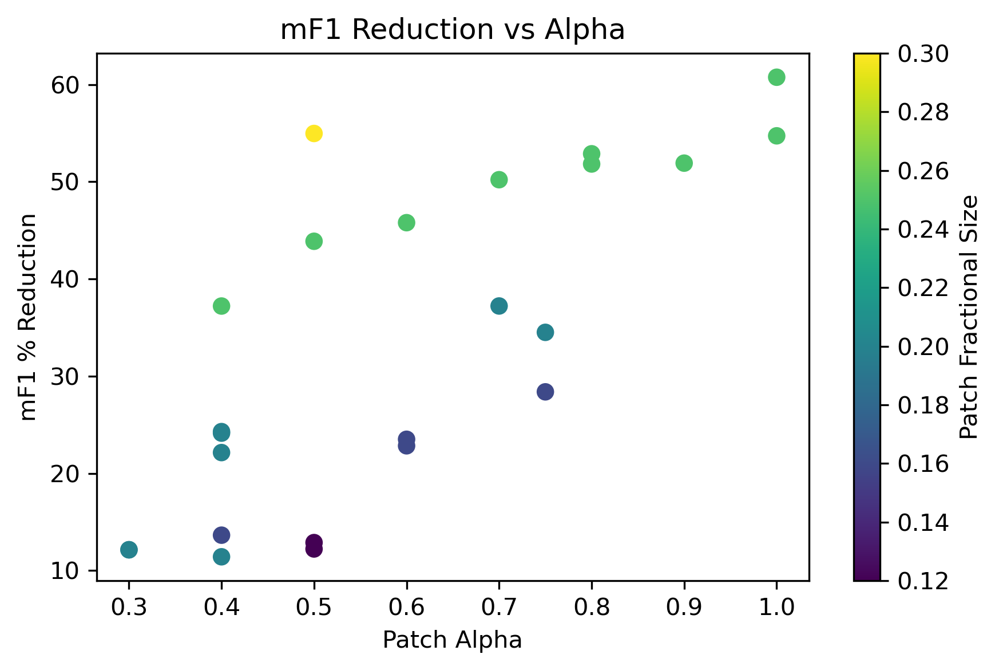

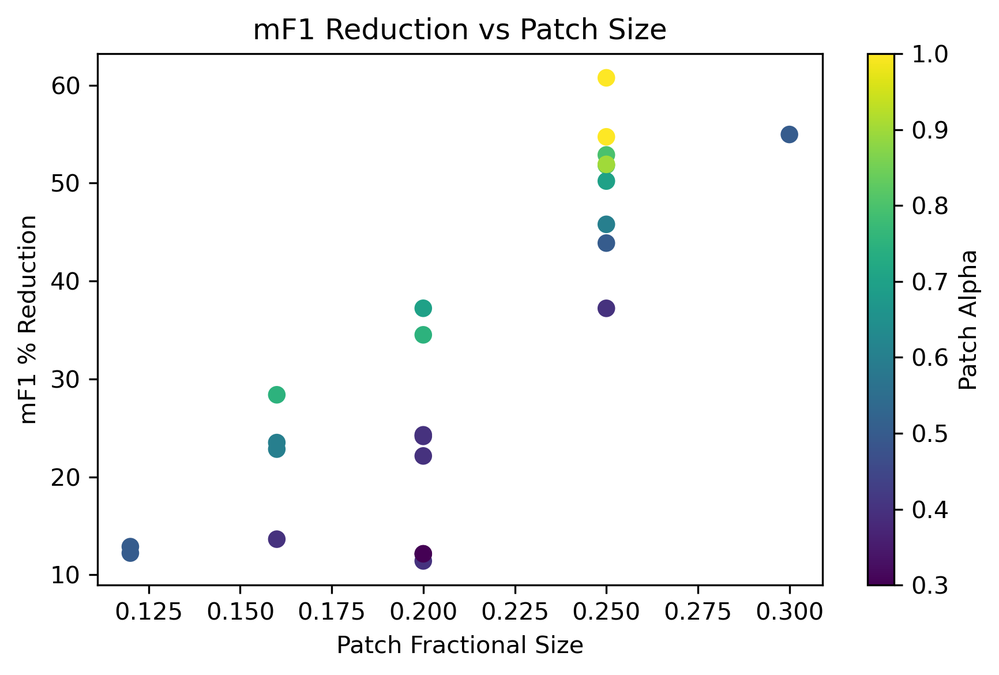

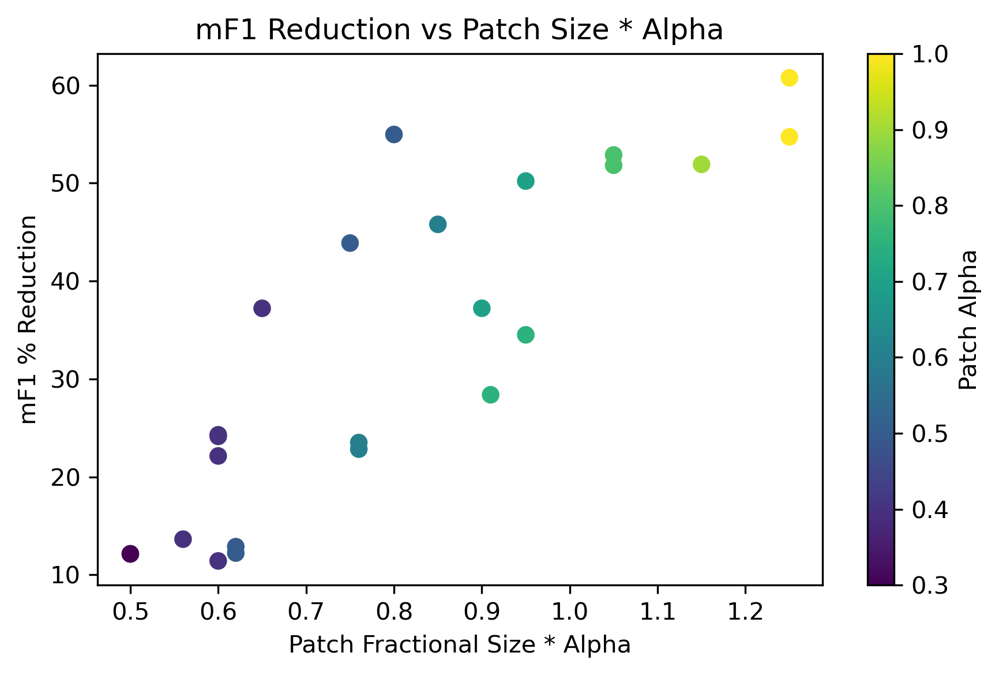

In [18]:
# Plot results

mpl.rcParams['figure.dpi'] = 300

yval = 'mF1 % Reduction'

import scipy.stats
z = scipy.stats.pearsonr(df_tot['alpha'].values, y=df_tot[yval].values) 
print("alpha", yval, "pearsonr:", z)
fig, ax0 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot['alpha'].values, y=df_tot[yval].values, 
            c=df_tot['target_size_frac'].values, cmap='viridis', s=40)
ax0.set_xlabel('Patch Alpha')
ax0.set_ylabel(yval)
plt.colorbar(label='Patch Fractional Size', ax=ax0)
ax0.set_title('mF1 Reduction vs Alpha')
plt.tight_layout()
plt.savefig('mf1_vs_alpha.png')

z = scipy.stats.pearsonr(df_tot['target_size_frac'].values, y=df_tot[yval].values) 
print("size", yval, "pearsonr:", z)
fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot['target_size_frac'].values, y=df_tot[yval].values, 
            c=df_tot['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size')
ax1.set_ylabel(yval)
plt.colorbar(label='Patch Alpha', ax=ax1)
ax1.set_title('mF1 Reduction vs Patch Size')
plt.tight_layout()
plt.savefig('mf1_vs_size.png')

fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot['alpha x size'].values, y=df_tot[yval].values, 
            c=df_tot['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size * Alpha')
ax1.set_ylabel(yval)
plt.colorbar(label='Patch Alpha', ax=ax1)
ax1.set_title('mF1 Reduction vs Patch Size * Alpha')
plt.tight_layout()
plt.savefig('mf1_vs_alpha*size.png')


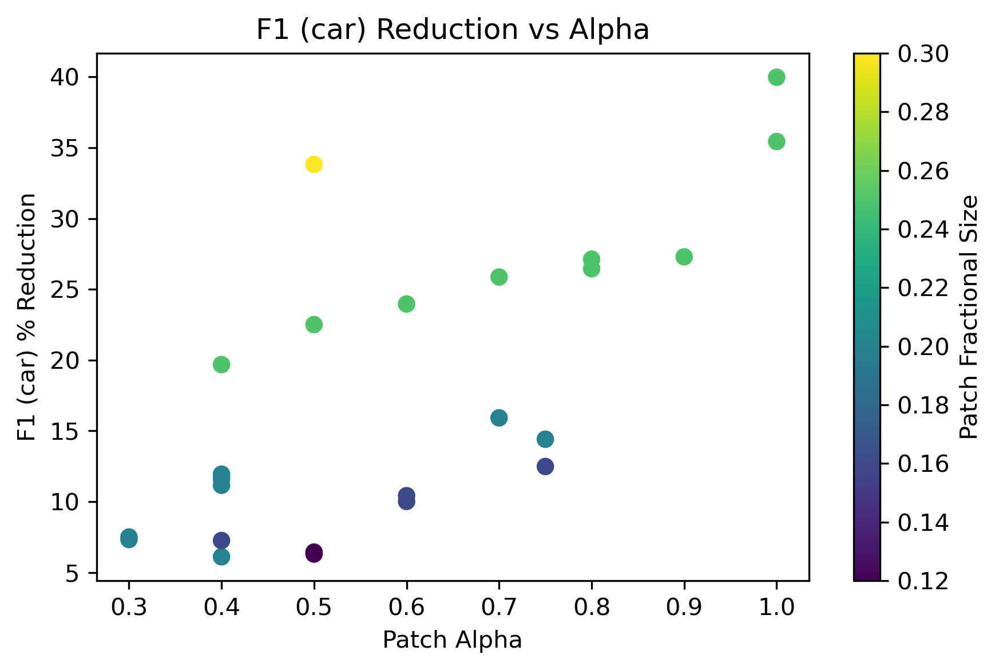

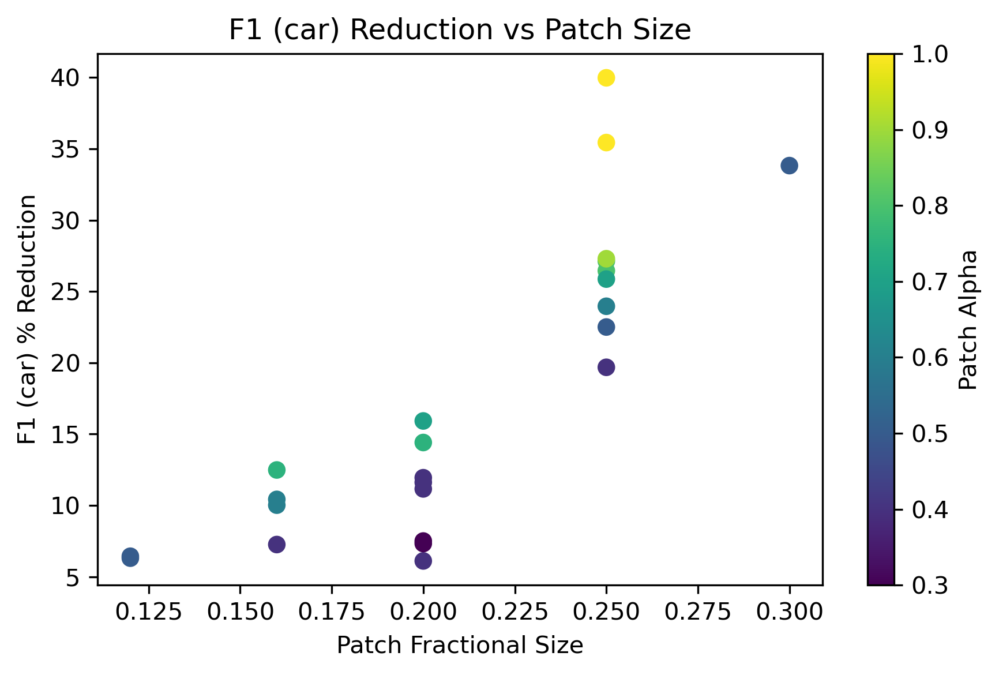

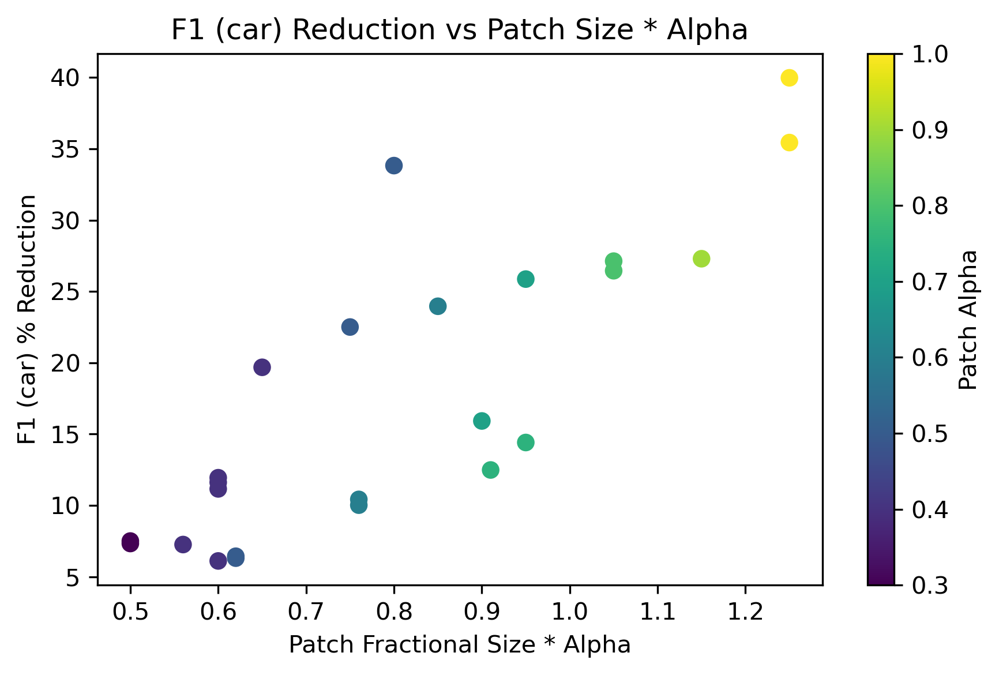

In [19]:
# car instead of mF1

mpl.rcParams['figure.dpi'] = 300

yval = 'F1 (car) % Reduction'

fig, ax0 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot['alpha'].values, y=df_tot[yval].values, 
            c=df_tot['target_size_frac'].values, cmap='viridis', s=40)
ax0.set_xlabel('Patch Alpha')
ax0.set_ylabel(yval)
plt.colorbar(label='Patch Fractional Size', ax=ax0)
ax0.set_title('F1 (car) Reduction vs Alpha')
plt.tight_layout()
plt.savefig('f1_vs_alpha_car.png')


fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot['target_size_frac'].values, y=df_tot[yval].values, 
            c=df_tot['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size')
ax1.set_ylabel(yval)
plt.colorbar(label='Patch Alpha', ax=ax1)
ax1.set_title('F1 (car) Reduction vs Patch Size')
plt.tight_layout()
plt.savefig('f1_vs_size_car.png')

fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot['alpha x size'].values, y=df_tot[yval].values, 
            c=df_tot['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size * Alpha')
ax1.set_ylabel(yval)
plt.colorbar(label='Patch Alpha', ax=ax1)
ax1.set_title('F1 (car) Reduction vs Patch Size * Alpha')
plt.tight_layout()
plt.savefig('f1_vs_alpha*size_car.png')


# Now apply patch detection model

Let us see how easy it is to detect the presence of each patch.

In [20]:
# create .txt and .data files of image paths

classnum = 1
exp_name = 'v1_4cat'

names_file = '/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patch_detect_10cat_generic_v0_all/txt/patch_detect_10cat_generic_v0_all.names'
# names_file = os.path.join(test_root, 'yolt', exp_name, 'txt', 'visdrone_v1_4cat.names')
print("names_file:", names_file)
!echo {names_file}

roots = [test_root]
# df_patches_tmp = df_patches_all
df_patches_tmp = df_patches_newnew
for root in roots:

    for idx,row in df_patches_tmp.iterrows():
        model = row['model']
        outname = model
        print("\nModel:", model)
    
        # Define paths
        input_im_dir = os.path.join(root, 'yolt/v1_4cat/images')
        input_label_dir = os.path.join(root, 'yolt/v1_4cat/labels')

        outdir = os.path.join(root, 'yolt', 'patches_applied', outname)
        outdir_txt = os.path.join(outdir, 'txt_patch_detect')
        outdir_images = os.path.join(outdir, 'images')
        outdir_labels = os.path.join(outdir, 'labels')
        # outdir_gdf = os.path.join(outdir, 'gdf')
        # outdir_labels_precise = os.path.join(outdir, 'labels_precise')
        # outdir_gdf_precise = os.path.join(outdir, 'gdf_precise')
        os.makedirs(outdir_txt, exist_ok=True)

        # make list of images
        outpath_txt_tmp = os.path.join(outdir_txt, outname + '_imlist.txt')
        im_dir_tmp = outdir_images
        im_list = [os.path.join(im_dir_tmp, z) for z in os.listdir(im_dir_tmp) if z.endswith('.jpg')]
        df_tmp = pd.DataFrame({'image': im_list})
        df_tmp.to_csv(outpath_txt_tmp, header=False, index=False)
        print("\nOutpath:\n", outpath_txt_tmp)
        print("  N images:", len(df_tmp))
        
        # .data file
        outfile_data_test = os.path.join(outdir_txt, outname + '.data')
        !echo 'classes = ' {classnum} > {outfile_data_test}
        !echo 'train = "" '  >> {outfile_data_test}
        !echo 'valid = ' {outpath_txt_tmp} >> {outfile_data_test}
        !echo 'names = ' {names_file} >> {outfile_data_test}
        !echo 'backup = backup/' >> {outfile_data_test}

        print("\nhead:", outfile_data_test)
        !cat {outfile_data_test}

names_file: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patch_detect_10cat_generic_v0_all/txt/patch_detect_10cat_generic_v0_all.names
/local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patch_detect_10cat_generic_v0_all/txt/patch_detect_10cat_generic_v0_all.names

Model: visdrone_v1_4cat_obj_only_tiny_gray_v1

Outpath:
 /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt_patch_detect/visdrone_v1_4cat_obj_only_tiny_gray_v1_imlist.txt
  N images: 11236

head: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt_patch_detect/visdrone_v1_4cat_obj_only_tiny_gray_v1.data
classes =  1
train = "" 
valid =  /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt_patch_detect/visdr

In [24]:
# create testing commands
cfg_file = 'cfg/_backup/yolt2_ave_26x26_visdrone_patch_detect_10cat_generic_v0.cfg'
weight_file = 'backup/yolt2_ave_26x26_visdrone_patch_detect_10cat_generic_v0_final.weights'

root = test_root
df_patch_tmp = df_patches_newnew
# df_patch_tmp = df_patches_all

for idx,row in df_patches_tmp.iterrows():
    model = row['model']
    outname = model
    outname_yolt = outname + '_patches_applied_detect_'
    outdir = os.path.join(root, 'yolt', 'patches_applied', outname)
    outdir_txt = os.path.join(outdir, 'txt_patch_detect')
    outfile_data_test = os.path.join(outdir_txt, outname + '.data')
    
    test_str = './darknet detector valid ' + outfile_data_test + ' ' \
        + cfg_file + ' ' + weight_file + ' ' \
        + '-out ' + outname_yolt
    
    print("\n#Model:", model)
    print("#test_str:\n")
    print(test_str)



#Model: visdrone_v1_4cat_obj_only_tiny_gray_v1
#test_str:

./darknet detector valid /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/txt_patch_detect/visdrone_v1_4cat_obj_only_tiny_gray_v1.data cfg/_backup/yolt2_ave_26x26_visdrone_patch_detect_10cat_generic_v0.cfg backup/yolt2_ave_26x26_visdrone_patch_detect_10cat_generic_v0_final.weights -out visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied_detect_


In [26]:
# post process (multithread)
import warnings
warnings.filterwarnings('ignore')

#### Same as above cell
n_threads = 12
extract_chips = False # True
detection_threshes = [0.3]  # [0.3, 0.35, 0.45]  #
slice_size = 0 # 416
sep = 'nope'
im_ext = '.jpg'
chip_ext = '.jpg'
show_labels = True
n_plots = 100
chip_rescale_frac = 1.1
allow_nested_detections = False # True
truth_file_name = '' # 'rareplanes_test_ims_fine_tune.geojson'
verbose = False

def post_process_one(model, outname, outname0):
    
    print("outname:", outname)
    raw_im_dir = os.path.join(test_root, 'yolt', 'patches_applied', outname0, 'images')
    # proot = outname.split('yolt2_ave_26x26_visdrone_')[-1]
    # raw_im_dir = os.path.join(test_root, 'yolt', proot, 'images')
    for detection_thresh in detection_threshes:
        out_dir_root = os.path.join(yoltv4_path, 'darknet', 'results', outname)
        pred_dir = os.path.join(out_dir_root, 'orig_txt')
        out_csv = 'preds_refine_' + str(detection_thresh).replace('.', 'p') + '.csv'
        out_geojson_geo_dir = 'geojsons_geo_' + str(detection_thresh).replace('.', 'p')
        out_geojson_pix_dir = 'geojsons_pix_' + str(detection_thresh).replace('.', 'p')
        if extract_chips:
            out_dir_chips = 'detection_chips_' + str(detection_thresh).replace('.', 'p')
        else:
            out_dir_chips = ''
        plot_dir = 'pred_plots_' + str(detection_thresh).replace('.', 'p')
        pred_txt_prefix = outname + '_'

        if len(truth_file_name) > 0:
            truth_file = os.path.join(data_root, 'test', 'geojsons_pix_comb', truth_file_name)
        else:
            truth_file = ''
        # move raw predictions to output dir
        os.makedirs(os.path.join(out_dir_root, 'orig_txt'), exist_ok=True)
        !mv {yoltv4_path}/darknet/results/{outname}*.txt {out_dir_root}/orig_txt/

        # post_process
        post_process.execute(
            pred_dir=pred_dir,
            truth_file=truth_file,
            raw_im_dir=raw_im_dir,
            # sliced_im_dir=sliced_im_dir,
            out_dir_root=out_dir_root,
            out_csv=out_csv,
            out_geojson_geo_dir=out_geojson_geo_dir,
            out_geojson_pix_dir=out_geojson_pix_dir,
            plot_dir=plot_dir,
            out_dir_chips=out_dir_chips,
            im_ext=im_ext,
            chip_ext=chip_ext,
            chip_rescale_frac=chip_rescale_frac,
            allow_nested_detections=allow_nested_detections,
            slice_size=slice_size,
            sep=sep,
            pred_txt_prefix=pred_txt_prefix,
            n_plots=n_plots,
            show_labels=show_labels,
            detection_thresh=detection_thresh,
            verbose=verbose)
        
        
##############
# multiprocess
    
import multiprocessing
from functools import partial
def map_wrapper(x):
    return x[0](*(x[1:]))

# get args
input_args = []
# for idx,row in df_patches_all.iterrows():
for idx,row in df_patches_newnew.iterrows():
    model = row['model']
    outname0 = model
    # outname = model + '_patches_applied'
    outname = outname0 + '_patches_applied_detect'
    input_args.append([post_process_one, model, outname, outname0])

with multiprocessing.Pool(n_threads) as pool:
     pool.map(map_wrapper, input_args)


outname: visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied_detect
Augmenting dataframe of initial length: 25389 ...
0
10000
20000
Time to augment dataframe of length: 25389 = 0.21193289756774902 seconds
Running refine_df()...
Initial length: 25389 Final length: 23919
Time to run refine_df(): 9.356256246566772 seconds

Creating geojsons and plots...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making output plot...
Making

## Score patch detection ability

In [27]:
detection_thresh = 0.3
n_threads = 12
prediction_cat_attrib="category"
gt_cat_attrib='category_generic'

# for idx,row in df_patches_all.iterrows():
def score_one(model):
    print("\nModel:", model)

    outname = model + '_patches_applied_detect'
    
    config = patch_config.patch_configs[model]()
    target_size_frac = config.target_size_frac
    alpha = config.patch_alpha

    gt_polygons_dir = os.path.join(test_root, 'yolt', 'patches_applied', model, 'gdf')
    proposal_polygons_dir = os.path.join(yoltv4_path, 'darknet', 'results', outname, 
                                     'geojsons_pix_' + str(detection_thresh).replace('.', 'p'))  
    score_file = os.path.join(yoltv4_path, 'darknet', 'results', outname, 'scores_' + str(detection_thresh).replace('.', 'p') + '_v1.csv')  

    if os.path.exists(score_file):
        print("Score file exists, overwriting {}".format(score_file))
        # print("Score file exists, skipping {}".format(score_file))
        # return

    else: 
        print("Ground Truth:", gt_polygons_dir)
        print("Proposals:", proposal_polygons_dir, "\n")

        object_subset, mAP, APs_by_class, mF1_score, f1s_by_class, precision_iou_by_obj,\
        precision_by_class, mPrecision, recall_iou_by_obj, recall_by_class, mRecall, confidences = \
            yolt_eval.mAP_score(proposal_polygons_dir, gt_polygons_dir,
                      prediction_cat_attrib=prediction_cat_attrib, gt_cat_attrib=gt_cat_attrib,
                      object_subset=[], threshold=0.5, confidence_attrib="prob",
                      file_format="geojson")
        print("object_subset:", object_subset)
        print("f1s_by_class:", f1s_by_class)
        print("mF1_score:", mF1_score)

        # create score df and file
        header = ['mF1'] + object_subset + ['target_size_frac', 'alpha']
        data = [mF1_score] + f1s_by_class + [target_size_frac, alpha]
        df_score = pd.DataFrame(columns=header, data=[data])
        df_score.to_csv(score_file)

##############
# multiprocess
    
# get args
input_args = []
# for idx,row in df_patches_all.iterrows():
for idx,row in df_patches_newnew.iterrows():
    model = row['model']
    input_args.append([score_one, model])

display(input_args)

with multiprocessing.Pool(n_threads) as pool:
    pool.map(map_wrapper, input_args)


[[<function __main__.score_one(model)>,
  'visdrone_v1_4cat_obj_only_tiny_gray_v1']]


Model: visdrone_v1_4cat_obj_only_tiny_gray_v1
Ground Truth: /local_data/cosmiq/wdata/avanetten/VisDrone/data/VisDrone2019-DET-test-dev/yolt/patches_applied/visdrone_v1_4cat_obj_only_tiny_gray_v1/gdf
Proposals: /local_data/cosmiq/src/avanetten/yoltv4/darknet/results/visdrone_v1_4cat_obj_only_tiny_gray_v1_patches_applied_detect/geojsons_pix_0p3 

getting unique objects...


100%|██████████| 11236/11236 [06:08<00:00, 30.52it/s]


calculating recall...


100%|██████████| 11236/11236 [10:04<00:00, 18.59it/s]


mRecall: 0.08837997948546189
calculating precision...


100%|██████████| 11236/11236 [09:40<00:00, 19.34it/s]


mPrecision: 0.17584347171704504
calculating F1 scores...
mF1: 0.11763560238333144
mAP: 0.03897559729737708 @IOU: 0.5
returning: object_subset, mAP, APs_by_class, mF1_score, f1s_by_class, precision_iou_by_obj, precision_by_class, mPrecision, recall_iou_by_obj, recall_by_class, mRecall, confidences
object_subset: ['patch']
f1s_by_class: [0.11763560238333144]
mF1_score: 0.11763560238333144


In [25]:
# get all scores
detection_thresh = 0.3
# get args
dfs = []
for idx,row in df_patches_all.iterrows():
    model = row['model']
    outname = model + '_patches_applied_detect'
    score_file = os.path.join(yoltv4_path, 'darknet', 'results', outname, 'scores_' + str(detection_thresh).replace('.', 'p') + '_v1.csv')  
    df_tmp = pd.read_csv(score_file)
    df_tmp['model'] = [model]
    dfs.append(df_tmp)

df_tot2 = pd.concat(dfs, ignore_index=True)
score_file_tot = os.path.join(yoltv4_path, 'darknet', 'results', 'visdrone_patches_applied_detect_scores_' + str(detection_thresh).replace('.', 'p') + '_v1.csv')  
df_tot2.to_csv(score_file_tot)

# add difference from native model
df_tot2['delta_F1'] = 0.55 - df_tot['mF1']
df_tot2['mF1 % Reduction'] = 100.0 * (0.55 - df_tot['mF1']) / 0.5
df_tot2['alpha x size'] = df_tot2['alpha'] + df_tot2['target_size_frac']

# add difference from native model (car)
df_tot2['car'] = df_tot['car']
df_tot2['delta_F1_car'] = 0.72 - df_tot['car']
df_tot2['F1 (car) % Reduction'] = 100.0 * (0.72 - df_tot['car']) / 0.5

# add native model ?
# Native model applied to pristine test set:
# 0.3
# mRecall: 0.5434637384413717
# mPrecision: 0.564606090089685
# calculating F1 scores...
# mF1: 0.5502705900345422
# mAP: 0.4627800066732362 @IOU: 0.5
# returning: object_subset, mAP, APs_by_class, mF1_score, f1s_by_class, precision_iou_by_obj, precision_by_class, mPrecision, recall_iou_by_obj, recall_by_class, mRecall, confidences
# object_subset: ['bus', 'car', 'truck', 'van']
# f1s_by_class: [0.5891989231445625, 0.7204086863479194, 0.43384729573432096, 0.4576274549113658]
# mF1_score: 0.5502705900345422

# dfnat = pd.DataFrame([[0, 0.5502705900345422, 0.5891989231445625, 0.7204086863479194, 
#                        0.43384729573432096, 0.4576274549113658, 0.35, 1, 'native']], columns=df_tot.columns)
# df_tot = df_tot.append(dfnat, ignore_index=True)

df_tot2

,Unnamed: 0,mF1,patch,target_size_frac,alpha,model,delta_F1,mF1 % Reduction,alpha x size,car,delta_F1_car,F1 (car) % Reduction
0,0,0.766350,0.766350,0.20,0.40,visdrone_obj_only_v0,0.110665,22.133090,0.60,0.664205,0.055795,11.158915
1,0,0.755667,0.755667,0.20,0.40,visdrone_obj_class_v0,0.120667,24.133459,0.60,0.660282,0.059718,11.943603
2,0,0.699748,0.699748,0.20,0.30,visdrone_obj_only_small_v0,0.060622,12.124314,0.50,0.682483,0.037517,7.503425
3,0,0.690183,0.690183,0.16,0.60,visdrone_v1_4cat_obj_only_small_v1,0.114149,22.829882,0.76,0.667880,0.052120,10.424049
4,0,0.698610,0.698610,0.16,0.60,visdrone_v1_4cat_obj_class_v3,0.117499,23.499718,0.76,0.669903,0.050097,10.019319
5,0,0.546940,0.546940,0.12,0.50,visdrone_v1_4cat_obj_only_v4,0.061079,12.215811,0.62,0.687811,0.032189,6.437701
6,0,0.862406,0.862406,0.30,0.50,visdrone_v1_4cat_obj_only_v5,0.274813,54.962503,0.80,0.550872,0.169128,33.825563
7,0,0.748304,0.748304,0.20,0.40,visdrone_v1_4cat_obj_only_v5p3,0.121454,24.290776,0.60,0.661916,0.058084,11.616806
8,0,0.874925,0.874925,0.25,0.60,visdrone_v1_4cat_obj_only_gray_v2p2,0.228927,45.785488,0.85,0.600179,0.119821,23.964284
9,0,0.816310,0.816310,0.20,0.70,visdrone_v1_4cat_obj_only_gray_v2p3,0.186068,37.213618,0.90,0.640389,0.079611,15.922181


Text(0.5, 1.0, 'mF1 Patch Detection vs Patch Size * Alpha')

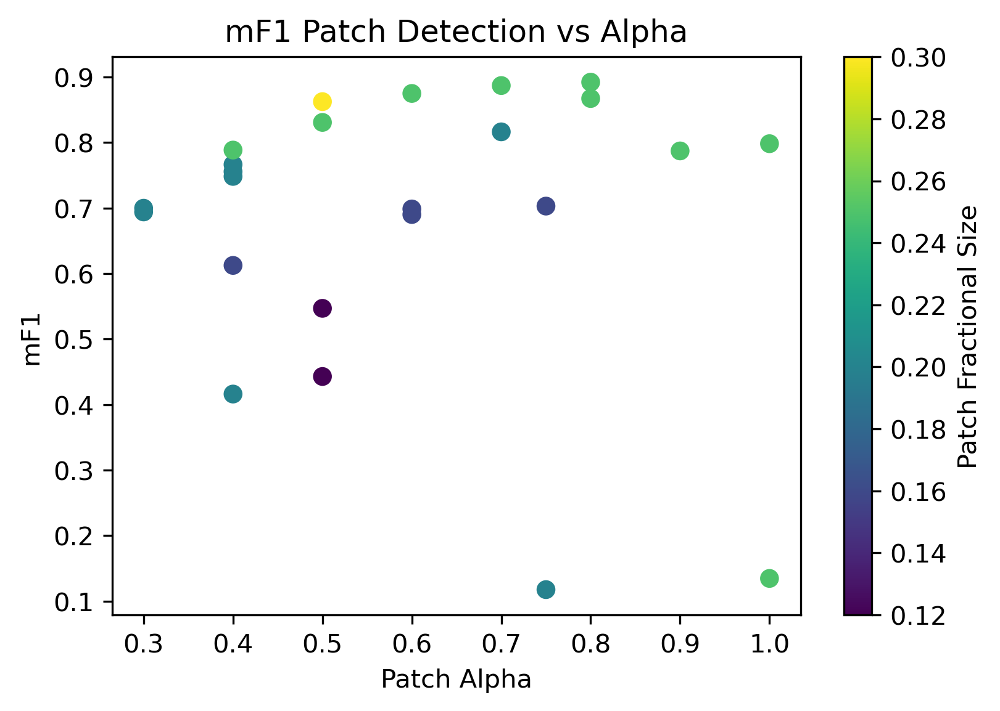

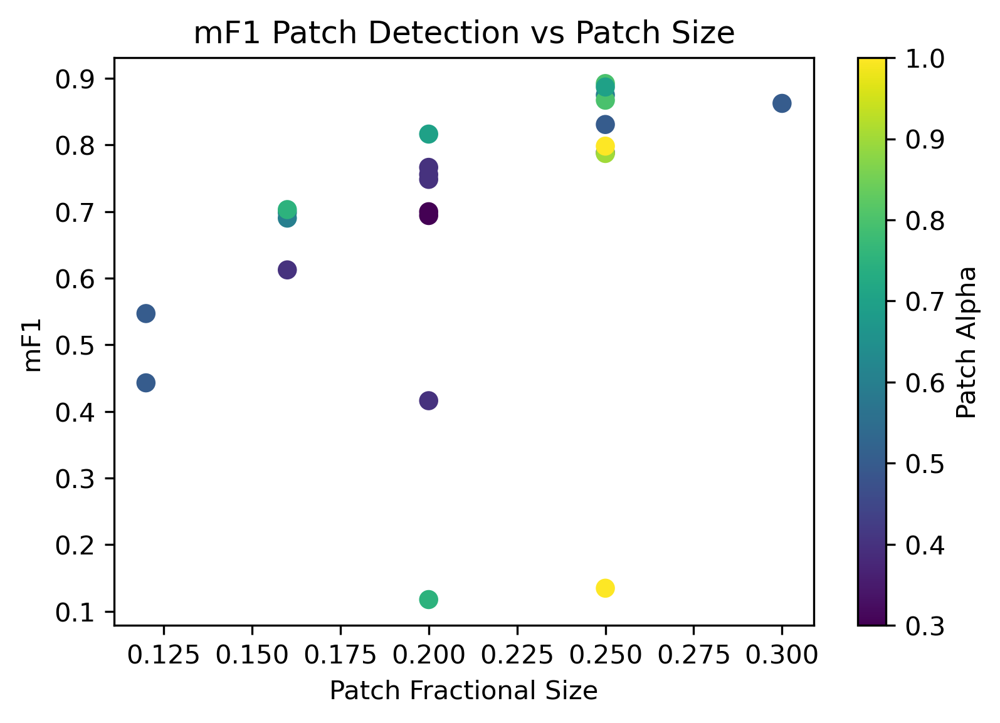

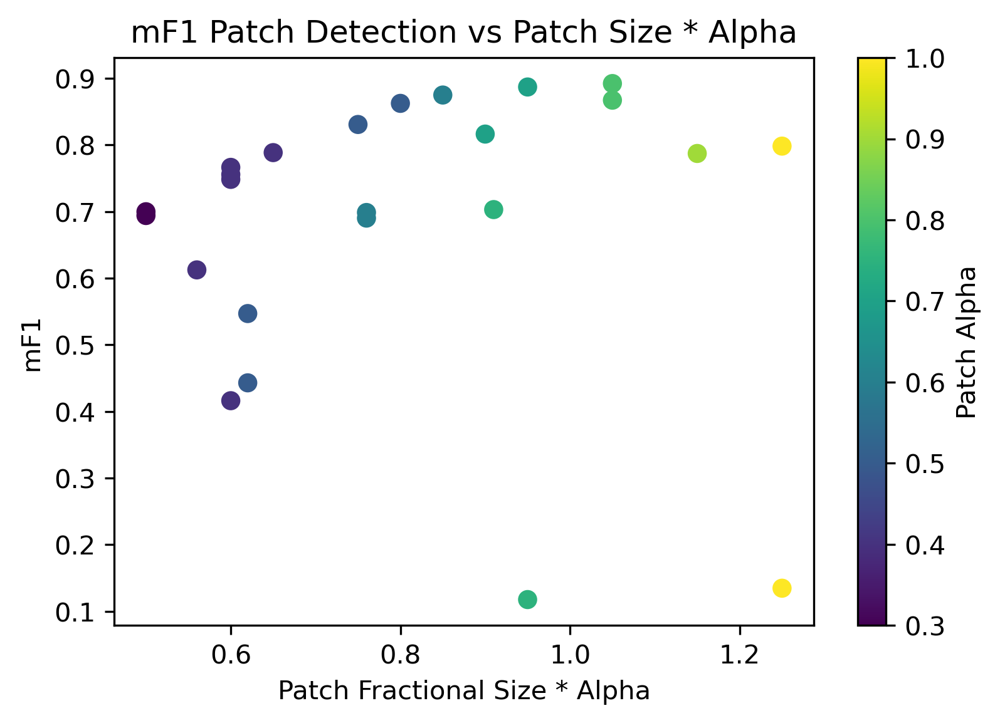

In [54]:
# plots
mpl.rcParams['figure.dpi'] = 300

yval = 'mF1' #'mF1 % Reduction'

fig, ax0 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot2['alpha'].values, y=df_tot2[yval].values, 
            c=df_tot2['target_size_frac'].values, cmap='viridis', s=40)
ax0.set_xlabel('Patch Alpha')
ax0.set_ylabel(yval)
plt.colorbar(label='Patch Fractional Size', ax=ax0)
ax0.set_title('mF1 Patch Detection vs Alpha')


fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot2['target_size_frac'].values, y=df_tot2[yval].values, 
            c=df_tot2['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size')
ax1.set_ylabel(yval)
plt.colorbar(label='Patch Alpha', ax=ax1)
ax1.set_title('mF1 Patch Detection vs Patch Size')


fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_tot2['alpha x size'].values, y=df_tot2[yval].values, 
            c=df_tot2['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size * Alpha')
ax1.set_ylabel(yval)
plt.colorbar(label='Patch Alpha', ax=ax1)
ax1.set_title('mF1 Patch Detection vs Patch Size * Alpha')


# Combine Vehicle and Patch Detection

In [36]:
# combine two dataframes
df_orig_filt = df_tot[['mF1', 'car', 'target_size_frac', 'alpha', 'model', 'delta_F1', 'alpha x size', 'mF1 % Reduction']]
df_orig_filt['mF1 (native)'] = 0.55
df_orig_filt['F1 car (native)'] = 0.72
df_orig_filt = df_orig_filt.rename(columns = {'mF1': 'mF1 (camo applied)', 'car': 'F1 (car)'})
# df_orig_filt

df_patch_filt = df_tot2[['model', 'mF1']]
df_patch_filt = df_patch_filt.rename(columns = {'mF1': 'F1 (patch detection)'})
# df_patch_filt

# join
df_join = df_orig_filt.merge(df_patch_filt, on=['model'])
df_join


# add a '*' to models in the training regime
models_of_interest = [
    'visdrone_obj_class_v0',
    'visdrone_obj_only_small_v0',
    'visdrone_obj_only_v0',
    'visdrone_v1_4cat_obj_class_v3',
    'visdrone_v1_4cat_obj_only_gray_v2p2',
    'visdrone_v1_4cat_obj_only_gray_v2p3',
    'visdrone_v1_4cat_obj_only_small_v1',
    'visdrone_v1_4cat_obj_only_v4',
    'visdrone_v1_4cat_obj_only_v5',
    'visdrone_v1_4cat_obj_only_v5p3'
]
for idx, row in df_join.iterrows():
    if row['model'] in models_of_interest:
        df_join.at[idx, 'model'] = row['model'] + '*'
        
print_names = [model.split("visdrone_")[-1].split("v1_4cat_")[-1] for model in df_join['model'].values]
df_join['Name'] = print_names

for col_tmp in ['mF1 (camo applied)', 'F1 (car)', 'F1 (patch detection)', 'mF1 % Reduction']:
    mean, std = df_join[col_tmp].mean(), df_join[col_tmp].std()
    print(col_tmp, "mean:", mean, "std", std)

df_join

mF1 (camo applied) mean: 0.3842731433672027 std 0.08394210011967035
F1 (car) mean: 0.6322758000861727 std 0.05148778246369784
F1 (patch detection) mean: 0.6846381555942238 std 0.2139977860105053
mF1 % Reduction mean: 33.14537132655946 std 16.78842002393407


,mF1 (camo applied),F1 (car),target_size_frac,alpha,model,delta_F1,alpha x size,mF1 % Reduction,mF1 (native),F1 car (native),F1 (patch detection),Name
0,0.439335,0.664205,0.20,0.40,visdrone_obj_only_v0*,0.110665,0.60,22.133090,0.55,0.72,0.766350,obj_only_v0*
1,0.429333,0.660282,0.20,0.40,visdrone_obj_class_v0*,0.120667,0.60,24.133459,0.55,0.72,0.755667,obj_class_v0*
2,0.489378,0.682483,0.20,0.30,visdrone_obj_only_small_v0*,0.060622,0.50,12.124314,0.55,0.72,0.699748,obj_only_small_v0*
3,0.435851,0.667880,0.16,0.60,visdrone_v1_4cat_obj_only_small_v1*,0.114149,0.76,22.829882,0.55,0.72,0.690183,obj_only_small_v1*
4,0.432501,0.669903,0.16,0.60,visdrone_v1_4cat_obj_class_v3*,0.117499,0.76,23.499718,0.55,0.72,0.698610,obj_class_v3*
5,0.488921,0.687811,0.12,0.50,visdrone_v1_4cat_obj_only_v4*,0.061079,0.62,12.215811,0.55,0.72,0.546940,obj_only_v4*
6,0.275187,0.550872,0.30,0.50,visdrone_v1_4cat_obj_only_v5*,0.274813,0.80,54.962503,0.55,0.72,0.862406,obj_only_v5*
7,0.428546,0.661916,0.20,0.40,visdrone_v1_4cat_obj_only_v5p3*,0.121454,0.60,24.290776,0.55,0.72,0.748304,obj_only_v5p3*
8,0.321073,0.600179,0.25,0.60,visdrone_v1_4cat_obj_only_gray_v2p2*,0.228927,0.85,45.785488,0.55,0.72,0.874925,obj_only_gray_v2p2*
9,0.363932,0.640389,0.20,0.70,visdrone_v1_4cat_obj_only_gray_v2p3*,0.186068,0.90,37.213618,0.55,0.72,0.816310,obj_only_gray_v2p3*


In [27]:
# make table of results
 
sep = " & "
sep2 = ""
header = sep + "Name" + sep +  "mF1_{camo}" + sep + "F1_{patch}" + r" \\"
# header = sep + "Name" + sep +  "F1_{camo}" + sep + "F1_{patch}" + r" \\"
print(header)

for idx, row in df_join.iterrows():
    name = row['Name'].replace(r'_', r'\_')
    tab_row = str(idx+1) + sep + name + sep \
              + "$" + str(np.round(row['mF1 (camo applied)'], 2)) + "$" + sep \
              + "$" + str(np.round(row['F1 (patch detection)'], 2)) + "$" + r" \\"
    print(tab_row)
              # + "$" + str(np.round(row['mF1 (car)'], 2)) + "$" + sep \


 & Name & mF1_{camo} & F1_{patch} \\
1 & obj\_only\_v0* & $0.44$ & $0.77$ \\
2 & obj\_class\_v0* & $0.43$ & $0.76$ \\
3 & obj\_only\_small\_v0* & $0.49$ & $0.7$ \\
4 & obj\_only\_small\_v1* & $0.44$ & $0.69$ \\
5 & obj\_class\_v3* & $0.43$ & $0.7$ \\
6 & obj\_only\_v4* & $0.49$ & $0.55$ \\
7 & obj\_only\_v5* & $0.28$ & $0.86$ \\
8 & obj\_only\_v5p3* & $0.43$ & $0.75$ \\
9 & obj\_only\_gray\_v2p2* & $0.32$ & $0.87$ \\
10 & obj\_only\_gray\_v2p3* & $0.36$ & $0.82$ \\
11 & class\_only\_v0 & $0.49$ & $0.42$ \\
12 & obj\_only\_small\_gray\_v0 & $0.49$ & $0.69$ \\
13 & obj\_only\_small\_gray\_v1 & $0.48$ & $0.61$ \\
14 & obj\_class\_small\_v2 & $0.41$ & $0.7$ \\
15 & obj\_only\_v2 & $0.29$ & $0.87$ \\
16 & obj\_only\_gray\_v2 & $0.29$ & $0.89$ \\
17 & obj\_class\_v4 & $0.49$ & $0.44$ \\
18 & obj\_only\_v5p1 & $0.33$ & $0.83$ \\
19 & obj\_only\_v5p2 & $0.36$ & $0.79$ \\
20 & obj\_only\_gray\_v2p1 & $0.3$ & $0.89$ \\
21 & class\_only\_v1 & $0.29$ & $0.79$ \\
22 & obj\_only\_tiny\_v0 & $0.28$ &

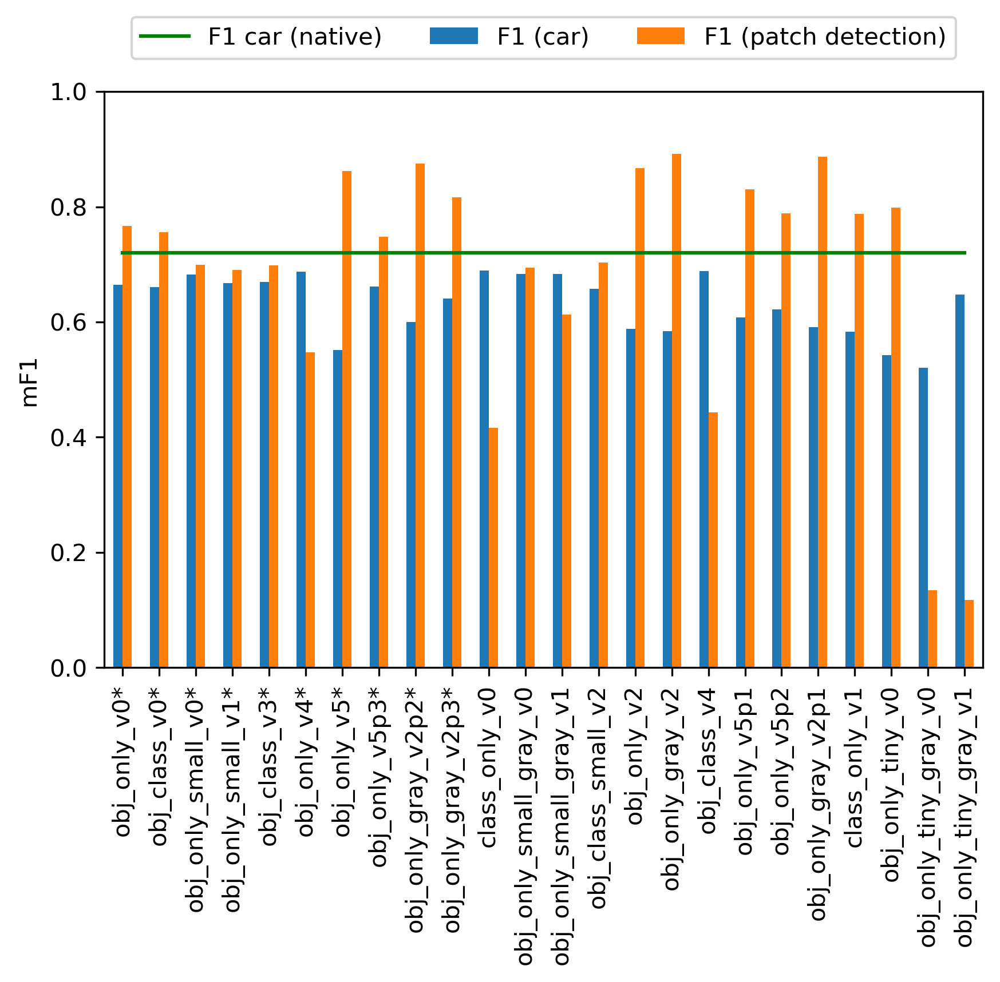

In [58]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6,6))
ax = df_join.plot(x='Name', y=['F1 car (native)'], kind='line', color='green', ax=ax)
ax = df_join.plot(x='Name', y=['F1 (car)', 'F1 (patch detection)'], kind='bar', ax=ax)
ax.set_ylim(0, 1.0)
# place legend
# https://stackoverflow.com/questions/4700614/how-to-put-the-legend-outside-the-plot-in-matplotlib
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15),#, 0.8, 0.05),
          ncol=3)#, fancybox=True)#, shadow=True)
#ax.legend(bbox_to_anchor=(1.1, 1.05))
#plt.tight_layout()
ax.set_xlabel('')
ax.set_ylabel('mF1')
plt.tight_layout()
plt.savefig('f1_bar_car.png')

(0.0, 1.0)

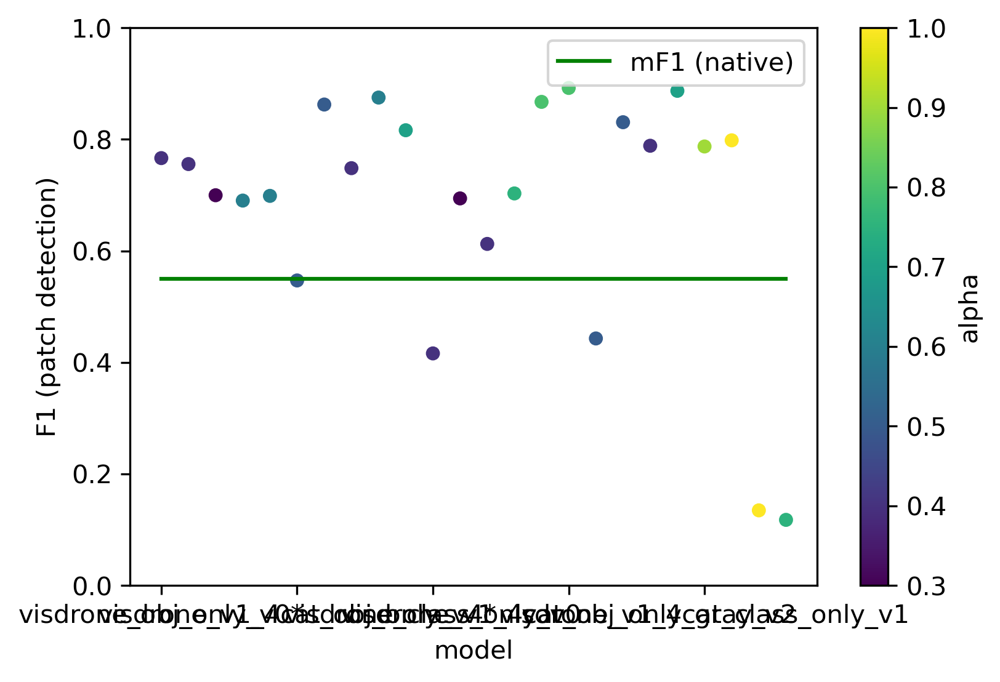

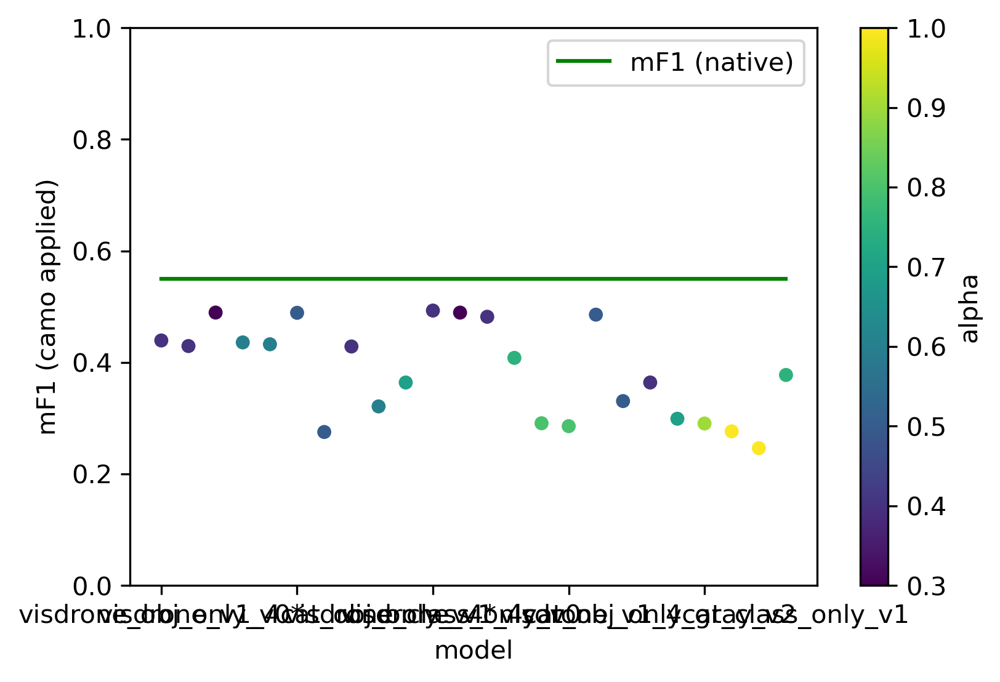

In [30]:
# a few more plots

ax = df_join.plot(x='model', y=['mF1 (native)'], kind='line', color='green')
ax = df_join.plot.scatter(x='model', y='F1 (patch detection)', c='alpha', cmap='viridis', ax=ax)
ax.set_ylim(0, 1)
#plt.xticks(rotation=90)

ax = df_join.plot(x='model', y=['mF1 (native)'], kind='line', color='green')
ax = df_join.plot.scatter(x='model', y='mF1 (camo applied)', c='alpha', cmap='viridis', ax=ax)
ax.set_ylim(0, 1.0)

(0.0, 1.0)

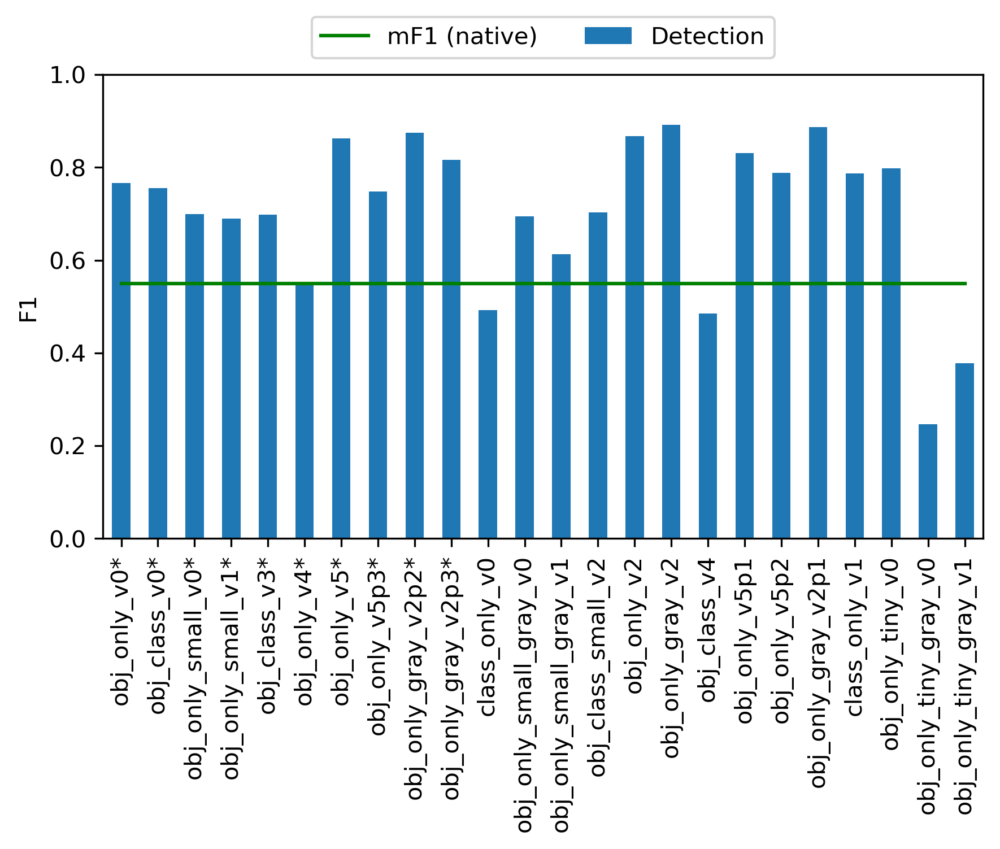

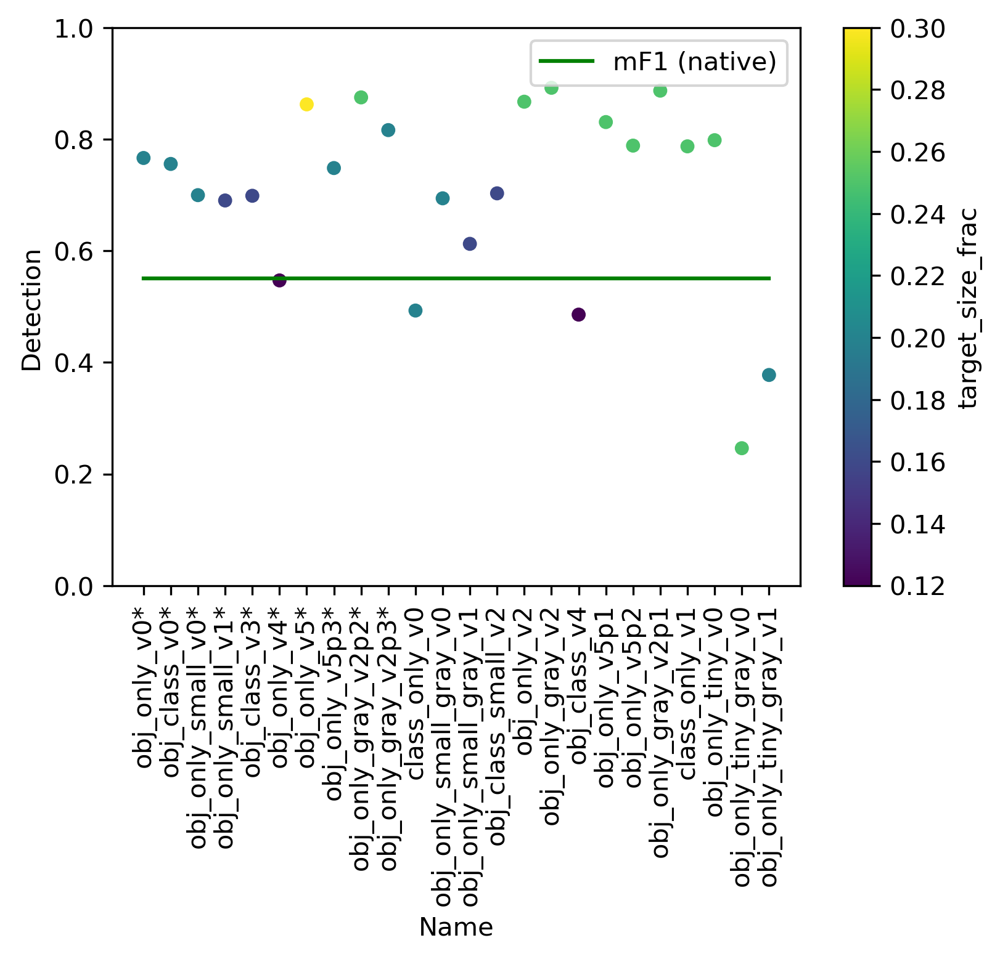

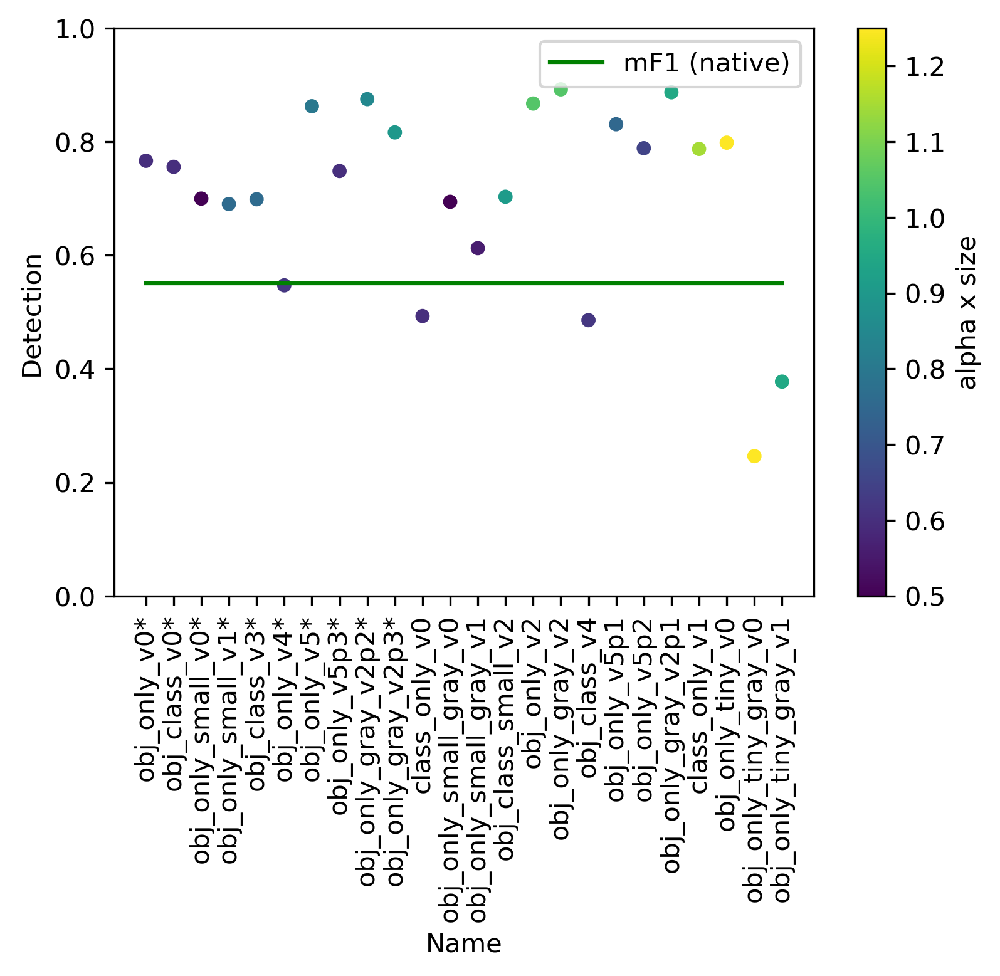

In [32]:
# plot camo efficacy vs ability to detect the patch
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(6,5.3))
df_join['Detection'] = df_join[['mF1 (camo applied)','F1 (patch detection)']].max(axis=1)
ax = df_join.plot(x='Name', y=['mF1 (native)'], kind='line', color='green', ax=ax)
ax = df_join.plot(x='Name', y=['Detection'], kind='bar', ax=ax)
xax_ticks = ax.get_xticks()
xax_labels = ax.get_xticklabels()
# https://stackoverflow.com/questions/4700614/how-to-put-the-legend-outside-the-plot-in-matplotlib
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15),#, 0.8, 0.05),
          ncol=3)#, fancybox=True)#, shadow=True)
#ax.legend(bbox_to_anchor=(1.1, 1.05))
#plt.tight_layout()
ax.set_xlabel('')
ax.set_ylabel('F1')
# print(xax_vals)
ax.set_ylim(0, 1)
plt.tight_layout()
plt.savefig('det.png')

# plot camo efficacy vs ability to detect the patch
ax = df_join.plot(x='Name', y=['mF1 (native)'], kind='line', color='green')
ax = df_join.plot.scatter(x='Name', y='Detection', c='target_size_frac', cmap='viridis', ax=ax)
ax.set_xticks(xax_ticks)
ax.set_xticklabels(xax_labels)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)#, ha='right')
ax.set_ylim(0, 1)

# plot camo efficacy vs ability to detect the patch
ax = df_join.plot(x='Name', y=['mF1 (native)'], kind='line', color='green')
ax = df_join.plot.scatter(x='Name', y='Detection', c='alpha x size', cmap='viridis', ax=ax)
ax.set_xticks(xax_ticks)
ax.set_xticklabels(xax_labels)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)#, ha='right')
ax.set_ylim(0, 1)



target_size_frac F1 (car) % Reduction pearsonr: (0.8315898058945982, 4.778523717528078e-07)
alpha F1 (car) % Reduction pearsonr: (0.7218419069726933, 6.840846810415864e-05)


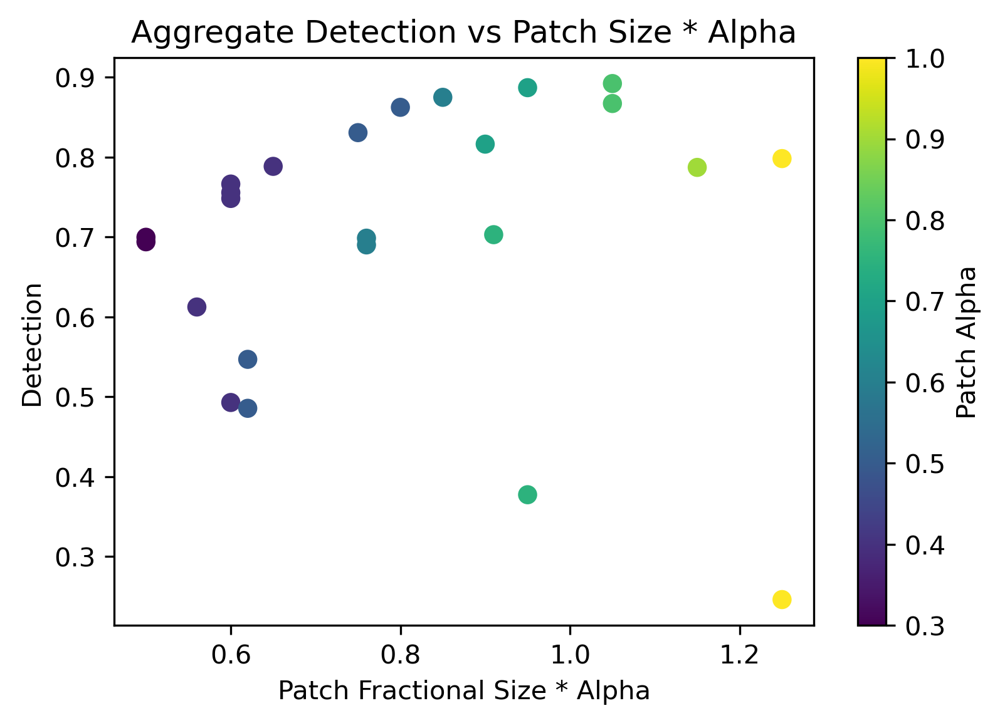

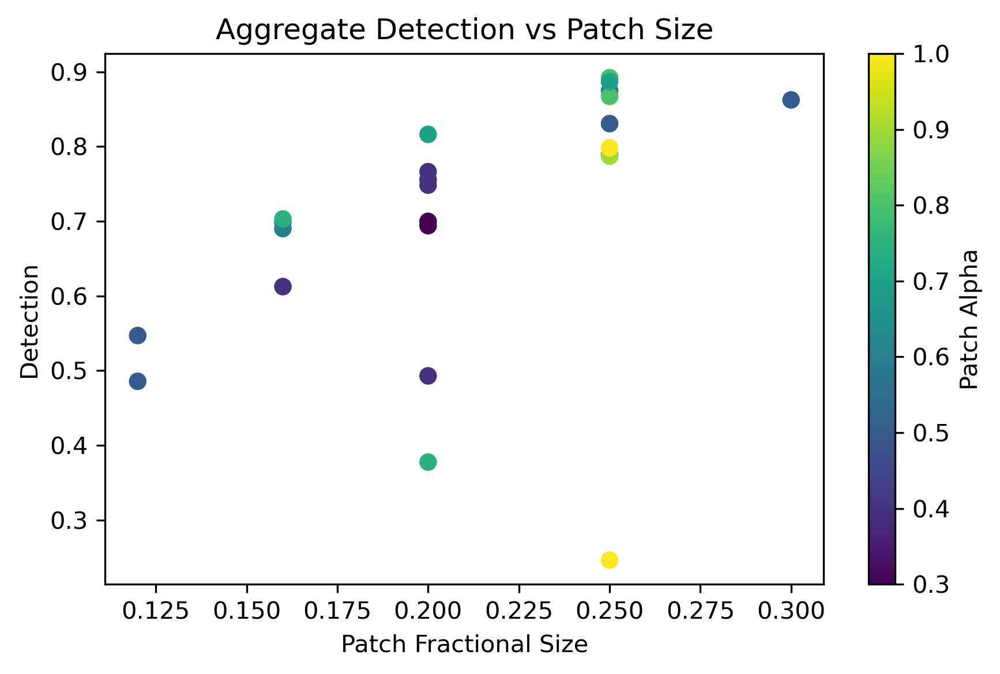

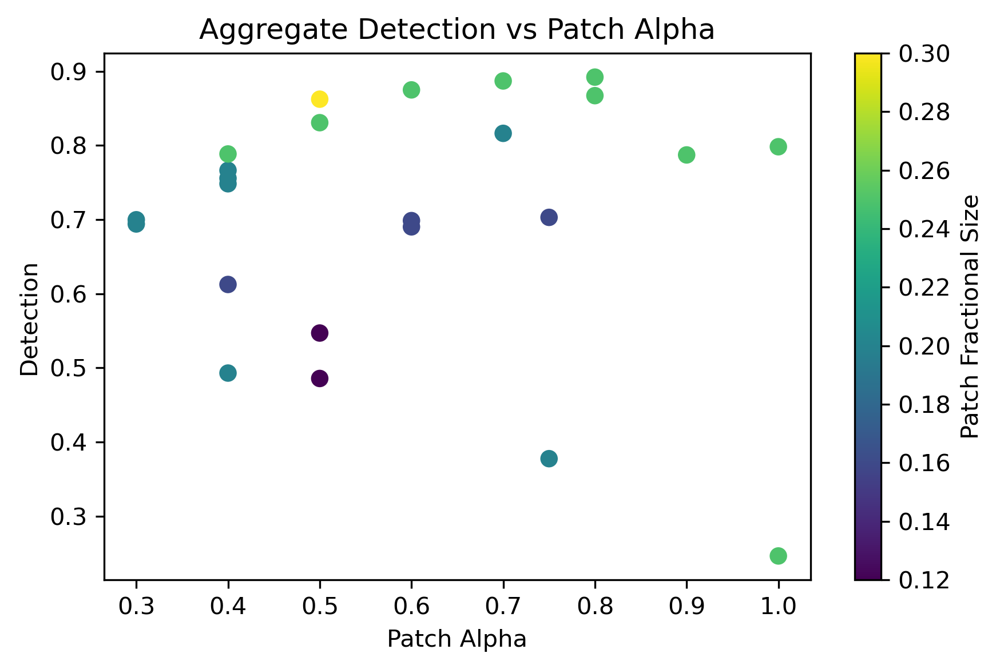

In [33]:
y_val = 'Detection'

# alpha * size
fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_join['alpha x size'].values, y=df_join[y_val].values, 
            c=df_join['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size * Alpha')
ax1.set_ylabel(y_val)
plt.colorbar(label='Patch Alpha', ax=ax1)
# plt.colorbar(label='Patch Alpha x Size', ax=ax1)
ax1.set_title('Aggregate Detection vs Patch Size * Alpha')

# size
z = scipy.stats.pearsonr(df_join['target_size_frac'].values, y=df_tot[yval].values) 
print("target_size_frac", yval, "pearsonr:", z)
fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_join['target_size_frac'].values, y=df_join[y_val].values, 
            c=df_join['alpha'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Fractional Size')
ax1.set_ylabel(y_val)
plt.colorbar(label='Patch Alpha', ax=ax1)
# plt.colorbar(label='Patch Alpha x Size', ax=ax1)
ax1.set_title('Aggregate Detection vs Patch Size')
plt.tight_layout()
plt.savefig('det_vs_size.png')

# alpha
z = scipy.stats.pearsonr(df_join['alpha'].values, y=df_tot[yval].values) 
print("alpha", yval, "pearsonr:", z)
fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
plt.scatter(x=df_join['alpha'].values, y=df_join[y_val].values, 
            c=df_join['target_size_frac'].values, cmap='viridis', s=40)
ax1.set_xlabel('Patch Alpha')
ax1.set_ylabel(y_val)
plt.colorbar(label='Patch Fractional Size', ax=ax1)
# plt.colorbar(label='Patch Alpha x Size', ax=ax1)
ax1.set_title('Aggregate Detection vs Patch Alpha')
plt.tight_layout()
plt.savefig('det_vs_alpha.png')
